In [32]:
# VAE w/o correlation regularization for BC
# archetype
# Ec as W

In [33]:
# load modules
import os
import sys
import gzip
import numpy as np
import scipy.stats as stats
import pandas as pd
import pickle
import anndata
import scanpy as sc
import scipy
import seaborn as sns

In [34]:
import phenograph # install from https://github.com/jacoblevine/PhenoGraph
import collections
from scipy.io import mmread,mminfo
from sklearn.decomposition import PCA

# Plotting imports
import matplotlib
import seaborn as sns
import matplotlib.pyplot as plt

In [35]:

sampleA_path = "/home/jiwei/miao/bc_visium_mod/data/2A/"#'/home/jiwei/miao/bc_visium/MICHELLE_0212_AHJTWTDRXX__Project_10778__Sample_Patient2A_021120_IGO_10778_3/outs/' #path to directory with 'spatial' file
sampleA_count = 'filtered_feature_bc_matrix.h5'
adA = sc.read_visium(path=sampleA_path, count_file = sampleA_count, library_id='2A')
adA.var_names_make_unique()

sampleB_path = "/home/jiwei/miao/bc_visium_mod/data/2B/"#'/home/jiwei/miao/bc_visium/MICHELLE_0212_AHJTWTDRXX__Project_10778__Sample_Patient2B_021120_IGO_10778_4/outs/' #path to directory with 'spatial' file
sampleB_count = 'filtered_feature_bc_matrix.h5'
adB = sc.read_visium(path=sampleB_path, count_file = sampleB_count, library_id='2B')
adB.var_names_make_unique()

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [36]:
plt.rcParams["figure.figsize"] = (8, 8)

... storing 'feature_types' as categorical
... storing 'genome' as categorical


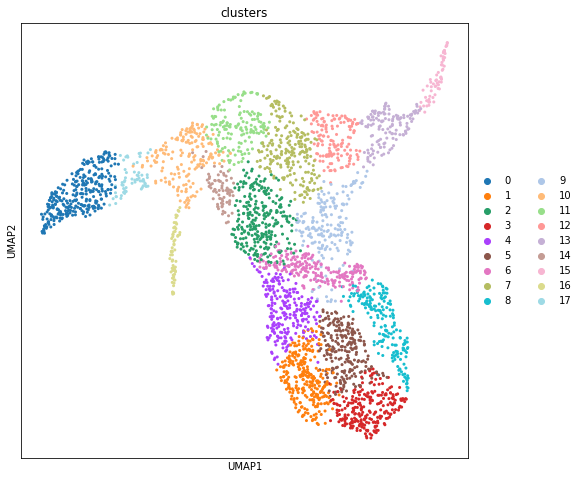

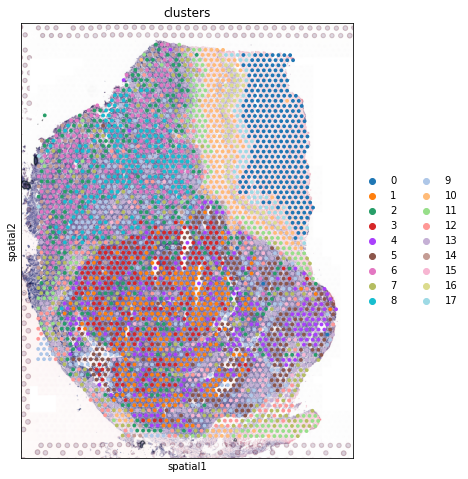

In [37]:
sc.pp.pca(adA)
sc.pp.neighbors(adA)
sc.tl.umap(adA)
sc.tl.leiden(adA, key_added="clusters")


sc.pl.umap(adA, color=["clusters"], wspace=0.4)

sc.pl.spatial(
        adA,
        img_key="hires",
        
        color="clusters"
    )

In [38]:
sc.tl.umap(adA,n_components=3)
sc.tl.leiden(adA, key_added="clusters")

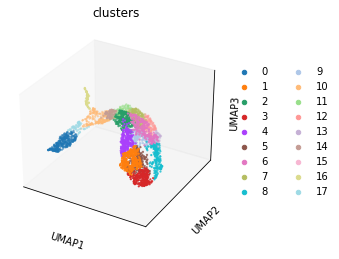

In [39]:
plt.rcParams["figure.figsize"] = (4, 4)
sc.pl.umap(adA, color=["clusters"], wspace=0.4,projection='3d')

In [40]:
#pip install py_pcha

In [41]:
from py_pcha import PCHA

#dimensions = 15
#examples = 100
#X = np.random.random((dimensions, examples))



In [42]:
eval_array = []
for ii in range(5,15):
    XC, S, C, SSE, varexpl = PCHA(adA.obsm['X_umap'].T, noc=ii, delta=0.1)
    print(ii,varexpl.shape)
    eval_array.append(varexpl)
eval_array = np.array(eval_array)
eval_array

5 ()
6 ()
7 ()
8 ()
9 ()
10 ()
11 ()
12 ()
13 ()
14 ()


array([0.99936922, 0.99934703, 0.99962177, 0.99967577, 0.99990066,
       0.99990046, 0.99990099, 0.9999001 , 0.99990028, 0.99990012])

In [43]:
no_c = 12
XC, S, C, SSE, varexpl = PCHA(adA.obsm['X_umap'].T, noc=no_c, delta=0.1)

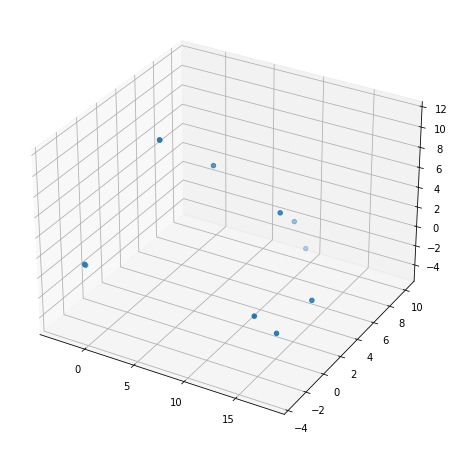

In [72]:
fig = plt.figure()
ax = fig.add_subplot(projection='3d')

ax.scatter(XC.T[:,0], XC.T[:,1], XC.T[:,2])

In [45]:
# check tissue location of archetypes


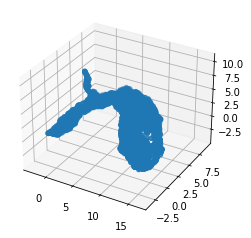

In [46]:
fig = plt.figure()
ax = fig.add_subplot(projection='3d')

ax.scatter(adA.obsm['X_umap'][:,0], adA.obsm['X_umap'][:,1], adA.obsm['X_umap'][:,2])

In [47]:
B = adA.obsm['X_umap']#np.array([[1,4],[2,5],[3,6]])
A = np.array(XC.T)#XC.T#np.array([[1,4],[3,6],[7,8]]) A, = np.array(M.T)



In [48]:
dist = np.linalg.norm(np.expand_dims(A,axis=1)-np.expand_dims(B,axis=0),axis=2)
dist.shape

(12, 3244)

pip install spams

In [49]:
print(A.shape,B.shape)

(12, 3) (3244, 3)


#https://people.math.ethz.ch/~chenyua/demo/code.html
import spams
k=10
robust = False # use robust archetypal analysis or not, default parameter(True)
epsilon = 1e-3 # width in Huber loss, default parameter(1e-3)
computeXtX = True # memorize the product XtX or not default parameter(True)
stepsFISTA = 0 # 3 alternations by FISTA, default parameter(3)
# a for loop in FISTA is used, we stop at 50 iterations
# remember that we are not guarantee to descent in FISTA step if 50 is too small
stepsAS = 10 # 7 alternations by activeSet, default parameter(50)
randominit = True # random initilazation, default parameter(True)

(Z,A,B) = spams.archetypalAnalysis(adA.obsm['X_umap'].T, returnAB= True, p = k)

alpha = spams.decompSimplex(adA.obsm['X_umap'].T,Z = Z, computeXtX = True, numThreads = -1)



from scipy.stats import wasserstein_distance
#wasserstein_distance(A[0,], B[0,])

wass_dist = np.empty((0,3244), float)
for i in range(A.shape[0]):
    tmp = []
    for j in range(B.shape[0]):
        tmp = np.append(tmp,wasserstein_distance(A[i,], B[j,]))
    #wass_dist=np.append(wass_dist,tmp, axis=0)
    wass_dist= np.vstack([wass_dist, tmp])

 

wass_dist_df = pd.DataFrame(wass_dist, index=[f'cell_{i}' for i in range(1,16)],columns = adA.obs.index)

arches_val = []
for i in adA.obs.index:
    # first find min dist of arche for current spot
    ct = wass_dist_df.index[wass_dist_df[i].argsort()[0]]
    # check if in the closest 60 spots for that arche
    if i in wass_dist_df.loc[ct].argsort()[0:300].index:#wass_dist_df.loc[ct].argsort()[0:59].index:
        arches_val = np.append(arches_val,ct)
    else:
        arches_val = np.append(arches_val,'nan')



In [82]:
dist_df = pd.DataFrame(dist, index=[f'cell_{i}' for i in range(1,no_c+1)],columns = adA.obs.index)
arches_val = []
for i in adA.obs.index:
    # first find min dist of arche for current spot
    ct = dist_df.index[dist_df[i].argsort()[0]]
    # check if in the closest 60 spots for that arche
    if i in dist_df.loc[ct].argsort()[0:300].index:#wass_dist_df.loc[ct].argsort()[0:59].index:
        arches_val = np.append(arches_val,ct)
    else:
        arches_val = np.append(arches_val,'nan')


In [83]:
unique_elements, counts_elements = np.unique(arches_val, return_counts=True)
print(unique_elements, counts_elements)

['cell_1' 'cell_10' 'cell_11' 'cell_12' 'cell_3' 'cell_4' 'cell_6'
 'cell_7' 'cell_8' 'nan'] [  25   21   13   68   17   36   56   61    3 2944]


In [84]:
adA.obs['arches_val'] = arches_val#adA.obs['arches_nn_val'] = arches_val

adA.obs['arches_val'] = 
sc.pl.spatial(adA,img_key="hires",color='arches_val',color_map='red')

... storing 'arches_val' as categorical


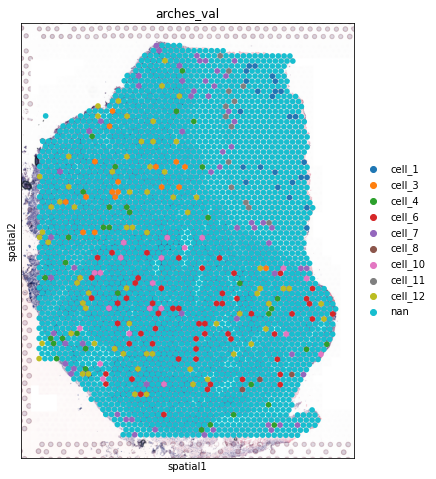

In [85]:
plt.rcParams["figure.figsize"] = (8, 8)
sc.pl.spatial(adA,img_key="hires",color='arches_val',spot_size=400)#,palette=zeileis_28

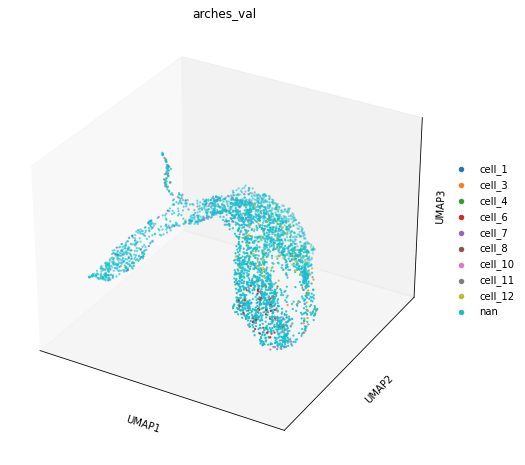

In [86]:
sc.pl.umap(adA,color='arches_val',projection='3d',size=5000)#palette=zeileis_28,

In [87]:
import scipy.sparse

exp_df = pd.DataFrame.sparse.from_spmatrix(adA.X)
exp_df.index = adA.obs.index
exp_df.columns = adA.var.index
exp_df.head()

,MIR1302-2HG,FAM138A,OR4F5,AL627309.1,AL627309.3,AL627309.2,AL627309.4,AL732372.1,OR4F29,AC114498.1,...,AC007325.2,BX072566.1,AL354822.1,AC023491.2,AC004556.1,AC233755.2,AC233755.1,AC240274.1,AC213203.1,FAM231C
AAACAATCTACTAGCA-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
AAACACCAATAACTGC-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
AAACAGCTTTCAGAAG-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
AAACAGGGTCTATATT-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
AAACAGTGTTCCTGGG-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [88]:
RPS_genes = [i for i in exp_df.columns.values if i.startswith('RPS')]
print(len(RPS_genes))
RPL_genes = [i for i in exp_df.columns.values if i.startswith('RPL')]
print(len(RPL_genes))
MT_genes = [i for i in exp_df.columns.values if i.startswith('MT-')]
print(len(MT_genes))

print(exp_df.shape)
exp_df.drop(RPS_genes, axis=1,inplace=True)#df.drop(['B', 'C'], axis=1)
print(exp_df.shape)
exp_df.drop(RPL_genes, axis=1,inplace=True)
print(exp_df.shape)
exp_df.drop(MT_genes, axis=1,inplace=True)
print(exp_df.shape)

48
56
13
(3244, 33538)
(3244, 33490)
(3244, 33434)
(3244, 33421)


# find 30 nearest neighbors
#s = numpy.array([2, 3, 1, 4, 5])
sort_index = np.argsort(wass_dist[0,:])
sort_index[-60:]
#wass_dist[0,sort_index[-60:]]#x[:-7]

i=0
sort_index = np.argsort(wass_dist[i,:])
arches = sort_index[-60:]
arches
arches_exp_df = exp_df.iloc[arches,]

arches_exp_df = pd.DataFrame(columns = exp_df.columns, 
                   index = [f'cell_{i}' for i in range(1,13)])


for i in range(1,wass_dist.shape[0]+1):#[f'cell_{i}' for i in range(1,13)]:
    sort_index = np.argsort(wass_dist[i-1,:])
    arches = sort_index[-60:]
    arches_exp_df.loc[f'cell_{i}'] = exp_df.iloc[arches,].sum(axis=0)/60#exp_df.loc[arches,]

In [89]:
arches_exp_df = pd.DataFrame(columns = exp_df.columns, 
                   index = [f'cell_{i}' for i in range(1,13)])


for i in range(1,dist.shape[0]+1):#[f'cell_{i}' for i in range(1,13)]:
    sort_index = np.argsort(dist[i-1,:])
    arches = sort_index[-60:]
    arches_exp_df.loc[f'cell_{i}'] = exp_df.iloc[arches,].sum(axis=0)/60#exp_df.loc[arches,]

print(arches_exp_df.shape)
arches_exp_df

    
    
binary = arches_exp_df.values>0
df = pd.DataFrame(binary,
                  columns=arches_exp_df.columns,
                  index=arches_exp_df.index)
    

mask = df.sum(axis=0)>2
mask.sum()

cols = df.columns[~mask]
df_sele = arches_exp_df[cols]#df[cols]
df_sele.shape

In [28]:
#arches = exp_df.index[np.argmin(wass_dist, axis=1)]#exp_df.index[np.argmin(dist, axis=1)]
#arches

In [29]:
# use differential expressed analysis

marks_sele = np.empty((0,50), str)#[]#pd.DataFrame(columns = ['g'+str(i) for i in range(50)],index=arches_exp_df.index)
for n, column in enumerate(df_sele.T):
    print(n,column)
    if len(df_sele.T[column].shape)==1:
        #np.array([[1,2,3]])
        marks_sele=np.append(marks_sele,np.array([df_sele.T[column].astype(float).nlargest(50).index.tolist()]), axis=0)#np.append(marks_sele,np.array([df_sele.T[column].nlargest(50).index.tolist()]), axis=0)
    else:
        marks_sele=np.append(marks_sele,np.array([df_sele.T[column].iloc[:,0].nlargest(50).index.tolist()]), axis=0)
        
dg = pd.DataFrame(marks_sele.T,columns=[f'cell_{i}' for i in range(1,13)])
dg

In [90]:
# degs 
from scipy import stats

adata.obs['groups'] = ['group 1' if int(i) < 9 else 'group 2' for i in adata.obs['louvain']]
sc.tl.rank_genes_groups(adata, groupby='groups', key_added='group_DE_results')

In [91]:
from scipy.stats import wasserstein_distance


cts = [f'cell_{i}' for i in range(1,16)]
arches_ss = adA.obs.loc[adA.obs['arches_val'].isin(cts)].index
cell_dic = {}


for ct in cts:
    ss = adA.obs.loc[adA.obs['arches_val']==ct].index
    others =list(set(arches_ss).difference(set(ss)))
    # select highly expressed genes in ct ss
    ss_exp_df = exp_df.loc[ss,]#
    ss_exp_df_n = ss_exp_df.loc[:,ss_exp_df.sum(axis=0)>20]
    #genes_sele = []
    tmp = []
    for g in ss_exp_df_n.columns:
        
        dis = wasserstein_distance(exp_df.loc[others,g], ss_exp_df_n.loc[ss,g])# [stat,pv] = stats.ttest_ind(exp_df.loc[others,g],ss_exp_df_n.loc[ss,g])
        #if pv<0.01:
        tmp = np.append(tmp,dis)
    
    da = {'Name':ss_exp_df_n.columns.values,
        'dist':tmp}
  
    tmp_df = pd.DataFrame(da)
    tmp_df.index = tmp_df['Name']
    genes_sele = tmp_df.loc[:,'dist'].argsort()[-50:].index.values.tolist()
        
    if len(genes_sele)>3:
        cell_dic[ct] = genes_sele




from scipy.stats import wasserstein_distance


cts = [f'cell_{i}' for i in range(1,16)]
arches_ss = adA.obs.loc[adA.obs['arches_val'].isin(cts)].index
cell_dic = {}


for ct in cts:
    ss = adA.obs.loc[adA.obs['arches_val']==ct].index
    others =list(set(arches_ss).difference(set(ss)))
    # select highly expressed genes in ct ss
    ss_exp_df = exp_df.loc[ss,]#
    ss_exp_df_n = ss_exp_df.loc[:,ss_exp_df.sum(axis=0)>20]
    #genes_sele = []
    tmp = []
    for g in ss_exp_df_n.columns:
        
        dis = wasserstein_distance(exp_df.loc[others,g], ss_exp_df_n.loc[ss,g])# [stat,pv] = stats.ttest_ind(exp_df.loc[others,g],ss_exp_df_n.loc[ss,g])
        #if pv<0.01:
        tmp = np.append(tmp,dis)
    
    da = {'Name':ss_exp_df_n.columns.values,
        'dist':tmp}
  
    tmp_df = pd.DataFrame(da)
    tmp_df.index = tmp_df['Name']
    genes_sele = tmp_df.loc[:,'dist'].argsort()[0:50].index
        
    if len(genes_sele)>3:
        cell_dic[ct] = genes_sele




cts = [f'cell_{i}' for i in range(1,16)]
arches_ss = adA.obs.loc[adA.obs['arches_val'].isin(cts)].index
cell_dic = {}


for ct in cts:
    ss = adA.obs.loc[adA.obs['arches_val']==ct].index
    others =list(set(arches_ss).difference(set(ss)))
    # select highly expressed genes in ct ss
    ss_exp_df = exp_df.loc[ss,]#
    ss_exp_df_n = ss_exp_df.loc[:,ss_exp_df.sum(axis=0)>20]
    genes_sele = []
    for g in ss_exp_df_n.columns:
        [stat,pv] = stats.ttest_ind(exp_df.loc[others,g],ss_exp_df_n.loc[ss,g])
        if pv<0.01:
            genes_sele = np.append(genes_sele,g)
    if len(genes_sele)>3:
        cell_dic[ct] = genes_sele



cts = [f'cell_{i}' for i in range(1,16)]
arches_ss = adA.obs.loc[adA.obs['arches_val'].isin(cts)].index
cell_dic = {}


for ct in cts:
    ss = adA.obs.loc[adA.obs['arches_val']==ct].index
    others =list(set(arches_ss).difference(set(ss)))
    # select highly expressed genes in ct ss
    ss_exp_df = exp_df.loc[ss,]#
    ss_exp_df_n = ss_exp_df.loc[:,ss_exp_df.sum(axis=0)>20]
    genes_sele = []
    for g in ss_exp_df_n.columns:
        [stat,pv] = stats.ttest_ind(exp_df.loc[others,g],ss_exp_df_n.loc[ss,g])
        if pv<0.01:
            genes_sele = np.append(genes_sele,g)
    if len(genes_sele)>3:
        cell_dic[ct] = genes_sele
            

In [92]:
#cell_dic
markers_df = pd.read_csv('/home/jiwei/miao/bc_visium_mod/Tcellsignatures_june2020_sele.csv')#pd.read_csv('/Users/xueerchen/Documents/spatial/bc/Tcellsignatures_june2020.csv')##('mouse_brain_marker_gene-SH.csv')
cells = markers_df.columns.values

#cell_dic = {}

for c in cells:
    cc = np.array(markers_df[c].values.tolist())
    cell_dic[c] = [x for x in cc if str(x) != 'nan']
    
    

In [93]:
# check overlap of markers
# if archetypes are some known pure cell types




In [94]:
print(len(cell_dic.keys()))
cell_dic.keys()

24


dict_keys(['cell_1', 'cell_3', 'cell_4', 'cell_6', 'cell_7', 'cell_8', 'cell_10', 'cell_11', 'cell_12', 'Th17', 'Treg', 'Th9', 'CD8 T cell \nactivation', 'Exhaustion/Terminal \ndifferentiation', 'CD8+ deletional \ntolerance', 'CD8+ TIL \ndysfunction', 'Effector cell \ncytotoxicity', 'bcell', 'Fibroblast', 'Monocyte', 'Macrophage', 'NK', 'BC', 'GNF2_MKI67'])

In [95]:
cell_dic

{'cell_1': ['TMSB10',
  'IGKC',
  'COX5B',
  'PTMA',
  'HINT1',
  'CD74',
  'HLA-A',
  'HLA-B',
  'EEF1A1',
  'CD24',
  'ACTB',
  'PPIA',
  'CHCHD2',
  'ATP5MF',
  'AZGP1',
  'TMSB4X',
  'CTSB',
  'TXN',
  'CTSD',
  'MDK',
  'FTH1',
  'COX8A',
  'FAU',
  'GSTP1',
  'GAPDH',
  'MYL6',
  'COX6A1',
  'TPT1',
  'IFI27',
  'IGHG3',
  'SERF2',
  'B2M',
  'ELOB',
  'NUPR1',
  'MT1E',
  'PFN1',
  'COL1A1',
  'MMP9',
  'UQCR11',
  'UBL5',
  'UBA52',
  'COX6B1',
  'TYROBP',
  'POLR2I',
  'APOE',
  'APOC1',
  'FTL',
  'IGLC2',
  'LGALS1',
  'CSTB'],
 'cell_3': ['SNU13',
  'SREBF2',
  'CENPM',
  'SMDT1',
  'NDUFA6',
  'CYB5R3',
  'TSPO',
  'SAMM50',
  'PARVB',
  'FBLN1',
  'ATXN10',
  'CRELD2',
  'PIM3',
  'TRABD',
  'PLXNB2',
  'TYMP',
  'BTG3',
  'ATP5PF',
  'APP',
  'CCT8',
  'SOD1',
  'CFAP298',
  'IFNGR2',
  'SON',
  'ATP5PO',
  'MRPS6',
  'RUNX1',
  'CBR1',
  'CBR3',
  'PIGP',
  'DSCR8',
  'PSMG1',
  'HMGN1',
  'BACE2',
  'FAM3B',
  'MX1',
  'TFF2',
  'NDUFV3',
  'PDXK',
  'CSTB',
  'PFKL',


In [36]:
#dg.to_csv('/Users/xueerchen/Documents/spatial/bc/archetype_markers6.csv',index=False)

ct=cts[0]
ct
arches_ss = adA.obs.loc[adA.obs['arches_val'].isin(cts)].index
ss = adA.obs.loc[adA.obs['arches_val']==ct].index
ss
others = list(set(arches_ss).difference(set(ss)))
len(others)

In [37]:
from __future__ import print_function, division

import os
GPU_id = 0
os.environ['CUDA_VISIBLE_DEVICES'] = str(GPU_id)
import os
import torch
import torch.nn as nn
import torch.nn.functional as F

from torch.autograd import Variable

import pandas as pd
import numpy as np

from sklearn.model_selection import train_test_split
from torch.utils.data import TensorDataset
import matplotlib.pyplot as plt

#import torchvision.datasets as datasets
from torch.utils.data import Dataset, DataLoader
#from torchvision import transforms, utils



# Ignore warnings
import warnings
warnings.filterwarnings("ignore")

plt.ion()   # interactive mode

In [38]:

sc.pp.normalize_total(adA, inplace=True)
sc.pp.log1p(adA)
sc.pp.highly_variable_genes(adA, flavor="seurat", n_top_genes=6000, inplace=True)

tmp = pd.DataFrame(adA.X.toarray(),index=adA.obs.index.values,columns=adA.var.index.values)
tmp.index.name = 'cell_id'
print(tmp.shape)

(3244, 33538)


In [39]:
class visiumDataset(Dataset):

    def __init__(self, exp_mat, transform=None):
        """
        Args:
            csv_file (string): Path to the csv file with annotations.
            root_dir (string): Directory with all the images.
            transform (callable, optional): Optional transform to be applied
                on a sample.
        """
        self.spot_gene_exp = exp_mat
        idx = self.spot_gene_exp.index
        x = self.spot_gene_exp.values
        x = np.log1p(x)
        self.spot_gene_exp = pd.DataFrame(x, columns=self.spot_gene_exp.columns, index=idx)
            
        #self.root_dir = root_dir
        #self.transform = transform

    def __len__(self):
        return len(self.spot_gene_exp)

    def __getitem__(self, idx):
        if torch.is_tensor(idx):
            idx = idx.tolist()

        sample = torch.Tensor(np.array(self.spot_gene_exp.iloc[idx,0:],dtype='float'))
        
        return sample





markers_df = dg#pd.read_csv('/home/jiwei/miao/bc_visium_mod/archetype_markers6.csv')#pd.read_csv('/home/jiwei/miao/bc_visium_mod/archetype_markers.csv')#pd.read_csv('/home/jiwei/miao/bc_visium_mod/Tcellsignatures_june2020_sele.csv')#pd.read_csv('/Users/xueerchen/Documents/spatial/bc/Tcellsignatures_june2020.csv')##('mouse_brain_marker_gene-SH.csv')
cells = markers_df.columns.values

cell_dic = {}

for c in cells:
    cell_dic[c] = markers_df[c].values.tolist()
    
 

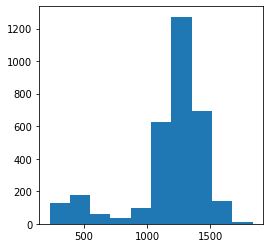

In [40]:
   

dt = tmp[tmp.columns.intersection(adA.var.loc[adA.var['highly_variable'] == True].index.values)]
vd = visiumDataset(exp_mat=dt)

import matplotlib.pyplot as plt
plt.hist(dt.sum(axis=1))
plt.show()

In [41]:
genes = dt.columns.values


valid_cell_dic = {}
for c,m1 in cell_dic.items():
    m2 = [i for i in m1 if i in genes]
    #print(c,m2)
    if len(m2)>0:
        valid_cell_dic[c] = m2
        
len(valid_cell_dic)

cell_gene_ids = {}
gene2id = {i:c for c,i in enumerate(dt.columns.values.tolist())}
for k,v in valid_cell_dic.items():
    cell_gene_ids[k] = [gene2id[j] for j in v]
cells = [k for k in cell_gene_ids]

In [42]:
cell_dic

{'cell_3': ['BST2',
  'CCDC124',
  'LSM4',
  'FKBP8',
  'UBA52',
  'REX1BD',
  'COPE',
  'DDX49',
  'HOMER3',
  'NDUFA13',
  'PDCD5',
  'LSM14A',
  'GPI',
  'UBA2',
  'FXYD3',
  'FXYD5',
  'TMEM147',
  'COX6B1',
  'PSENEN',
  'TYROBP',
  'SYNE4',
  'POLR2I',
  'TBCB',
  'CAPNS1',
  'SPINT2',
  'EIF3K',
  'FBL',
  'APOE',
  'APOC1',
  'SNRPD2',
  'AP2S1',
  'SELENOW',
  'FTL',
  'UBE2S',
  'RANBP1',
  'IGLC2',
  'MIF',
  'SNRPD3',
  'UQCR10',
  'SELENOM',
  'LGALS1',
  'POLR2F',
  'RBX1',
  'SNU13',
  'TSPO',
  'ATP5PF',
  'SOD1',
  'ATP5PO',
  'HMGN1',
  'CSTB'],
 'cell_4': ['PGLS',
  'CCDC124',
  'LSM4',
  'UBA52',
  'REX1BD',
  'COPE',
  'NDUFA13',
  'PDCD5',
  'GPI',
  'TMEM147',
  'RBM42',
  'COX6B1',
  'PSENEN',
  'TYROBP',
  'SDHAF1',
  'SYNE4',
  'POLR2I',
  'TBCB',
  'CAPNS1',
  'SPINT2',
  'PSMD8',
  'EIF3K',
  'PLD3',
  'RABAC1',
  'APOE',
  'APOC1',
  'SNRPD2',
  'AP2S1',
  'SELENOW',
  'FTL',
  'PRMT1',
  'UBE2S',
  'RANBP1',
  'IGLC2',
  'IGLC3',
  'MMP11',
  'MIF',
  'UQC

In [43]:
batch_size = 128

train_loader = torch.utils.data.DataLoader(
                 dataset=vd,#dataset=train_set,
                 batch_size=batch_size,
                 shuffle=True,
                 num_workers=8,
                 #prefetch_factor=64,
)

x = next(iter(train_loader))
x.shape

x.min(), x.max(), x.mean()

(tensor(0.), tensor(2.2826), tensor(0.1283))

In [44]:
x.shape

torch.Size([128, 6000])

In [45]:
class VAE(nn.Module):
    def __init__(self):
        super(VAE,self).__init__()

        #Latent View
        #self.lv = nn.Linear(50,20)
        
        
        self.encoder = nn.Sequential(
            nn.Linear(6000,400),
            nn.ReLU(),
            nn.Linear(400,len(valid_cell_dic)),#50
            #nn.ReLU(),
        )
        
         # distribution parameters
        # bottleneck size is 20
        #self.fc_mu = nn.Linear(50, 20)
        #self.fc_var = nn.Linear(50, 20)
        
        #self.fc_mu_w = torch.nn.Parameter(torch.rand(50,20))
        self.fc_mu_b = torch.nn.Parameter(torch.rand(len(valid_cell_dic)))
        
        self.fc_var_w = torch.nn.Parameter(torch.rand(len(valid_cell_dic),len(valid_cell_dic)))
        self.fc_var_b = torch.nn.Parameter(torch.rand(len(valid_cell_dic)))
        
        self.decoder = nn.Sequential(
            nn.Linear(len(valid_cell_dic),len(valid_cell_dic)),#50
            nn.ReLU(),
            nn.Linear(len(valid_cell_dic),400),#50
            nn.ReLU(),
            nn.Linear(400,6000),
        )
        
        # distribution parameters
        # bottleneck size is 20
        #self.fc_mu = nn.Linear(100, 20)
        #self.fc_var = nn.Linear(100, 20)

        # for the gaussian likelihood ????
        self.log_scale = nn.Parameter(torch.Tensor([0.0]))
        
        
    def forward(self, x, sample_cell_genes):
        # encode x to get the mu and variance parameters
        x_encoded = self.encoder(x)
        x_sample_cell = self.encoder(sample_cell_genes)
        
        mu = torch.matmul(x_encoded, x_sample_cell.T) + self.fc_mu_b#torch.matmul(x_encoded, self.fc_mu_w+x_sample_cell.T) + self.fc_mu_b
        log_var = torch.matmul(x_encoded, self.fc_var_w) + self.fc_var_b#torch.matmul(x_encoded, self.fc_var_w+x_sample_cell.T) + self.fc_var_b
       
        
        # sample z from q
        std = torch.exp(log_var / 2)
        eps = torch.randn_like(std)
        z = mu + (eps*std)
        #q = torch.distributions.Normal(mu, std)
        #z = q.rsample()

        # decoded 
        x_hat = vae.decoder(z) #?? self.
        return x_encoded,x_sample_cell,x_hat,z,mu,std
        

In [46]:
def gaussian_likelihood(mean, logscale, sample):
    scale = torch.exp(logscale)
    dist = torch.distributions.Normal(mean, scale)
    log_pxz = dist.log_prob(sample)
    return log_pxz.sum(dim=1)

def kl_divergence(z, mu, std):
    # --------------------------
    # Monte carlo KL divergence
    # --------------------------
    # 1. define the first two probabilities (in this case Normal for both)
    p = torch.distributions.Normal(torch.zeros_like(mu), torch.ones_like(std))
    q = torch.distributions.Normal(mu, std)

    # 2. get the probabilities from the equation
    log_qzx = q.log_prob(z)
    log_pz = p.log_prob(z)

    # kl
    kl = (log_qzx - log_pz)
    kl = kl.sum(-1)
    return kl

In [47]:
def correlation_coefficient(X,Y):
    # E((X-uX)(Y-uY))/std(X)/std(Y)
    # X,Y are 1-d pytorch tensors
    # X,Y mush have the same length
    assert X.shape[0] == Y.shape[0]
    n = X.shape[0]
    ux = X.mean()
    uy = Y.mean()
    sx = X.std() + 1e-7
    sy = Y.std() + 1e-7
    return ((X-ux)*(Y-uy)).mean()/sx/sy/(n-1)*n

def one_bn_one_cell_correlation(bn_i, cell_j):
    # bn_i: the value of i_th bottleneck neuron
    # cell_j: the gene expresseions of j_th cell
    # bn_i shape: [B], where B is the batch size
    # cell_j shape: [B,G], where G is the number of genes of cell_j
    # return mean correlation coefficient of bn_i w.r.t cell_j's genes
    result = 0
    for k in range(cell_j.shape[1]):
        result += correlation_coefficient(bn_i, cell_j[:,k])
    return result/cell_j.shape[1]

def all_bn_all_cell_correlation(bn, cells):
    # bn: the value of bottleneck neurons
    # bn shape: [B,N], where B is the batch size, 
    #              N is the number of neurons in bottleneck layer
    # cells: a list of predefined M cells
    #      each element is the gene expression of that cell
    #      element shape: [B,G], where G is the number of genes of cell_j  
    # return shape [N,M] the correlation coefficient of each bottleneck 
    #        neuron w.r.t. gene expressions of each cell
    result = []
    for b in range(bn.shape[1]):
        tmp = []
        for cell in cells:
            tmp.append(one_bn_one_cell_correlation(bn[:,b],cell))
        tmp = torch.stack(tmp)
        result.append(tmp)
    result = torch.stack(result)
    return result

bar = torch.tensor(0).cuda()
def hinge_loss_corr(corr, margin=2):
    # corr is a correlation coefficient matrix
    #      shape: [M,N]
    # where M is number of predefined cells
    #       N is number of bottleneck neurons
    
    
    min_dists,_ = torch.topk(corr,k=2,dim=1,sorted=True,largest=True) #higher weights of loss on spots with only one cell type(purity score)
    # min_dists[:,0] is the shortest distances
    # min_dists[:,1] is the 2nd shortest distances
    loss = torch.maximum(min_dists[:,1] - min_dists[:,0] + margin, bar)#torch.maximum(min_dists[:,0] - min_dists[:,1], torch.tensor(-margin).cuda())
    return loss.mean()

genes = dt.columns.values


valid_cell_dic = {}
for c,m1 in cell_dic.items():
    m2 = [i for i in m1 if i in genes]
    #print(c,m2)
    if len(m2)>0:
        valid_cell_dic[c] = m2
        
len(valid_cell_dic)

cell_gene_ids = {}
gene2id = {i:c for c,i in enumerate(dt.columns.values.tolist())}
for k,v in valid_cell_dic.items():
    cell_gene_ids[k] = [gene2id[j] for j in v]
cells = [k for k in cell_gene_ids]

cell_probs = np.random.rand(len(cell_gene_ids))
cell_probs = cell_probs/cell_probs.sum()
cell_cum_probs = np.cumsum(cell_probs)
cell_cum_probs

def sample_cell_ids(N):
    x = np.random.rand(5)
    cell_ids = np.searchsorted(cell_cum_probs, x)
    return x,cell_ids

def sample_cell_genes(N):
    x = np.zeros((N,6000))*1.0
    _,cell_ids = sample_cell_ids(N)
    for c,i in enumerate(cell_ids):
        x[c,cell_gene_ids[cells[i]]] = 2.0
    return x

x,cell_ids = sample_cell_ids(N=5)
print(x)
print(cell_ids)

In [48]:
# fixed cell type samples
def fix_cell_genes(N=len(cell_gene_ids.keys())):
    x = np.zeros((N,6000))*1.0
    cell_ids = cell_gene_ids.keys()
    for c,i in enumerate(cell_ids):
        x[c,cell_gene_ids[cells[c]]] = 2.0
    return x

In [49]:
cell_gene_ids.keys()

dict_keys(['cell_3', 'cell_4', 'cell_6', 'cell_7', 'cell_10', 'cell_11', 'cell_12', 'Th17', 'Treg', 'Th9', 'CD8 T cell \nactivation', 'CD8+ deletional \ntolerance', 'CD8+ TIL \ndysfunction', 'Effector cell \ncytotoxicity', 'bcell', 'Fibroblast', 'Monocyte', 'Macrophage', 'NK', 'BC', 'GNF2_MKI67'])

In [50]:
sample_signatures = fix_cell_genes(N=len(cell_gene_ids.keys()))
sample_signatures

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [51]:
%%time

# move data to gpu
vae = VAE()
print(vae)
vae_gpu = vae.cuda()
optimizer = torch.optim.Adam(vae_gpu.parameters(),lr=1e-3)


EPOCHS = 500
for epoch in range(EPOCHS):
    losses = []
    elbos = []
    corr_ls = []
    for batch_idx,data in enumerate(train_loader):
        #data = torch.autograd.Variable(data)
        data = data.cuda()
        sample_signatures = fix_cell_genes(N=len(cell_gene_ids.keys()))#sample_cell_genes(20)
        sample_signatures = torch.from_numpy(sample_signatures).float().cuda()
        optimizer.zero_grad()
        #x_encoded,x_sample_cell,x_hat,z,mu,std
        x_encoded,x_end,x_hat,z,mu,std = vae_gpu(data,sample_signatures)
        
        # reconstruction loss
        #recon_loss = F.mse_loss(x_hat,data)
        #recon_loss = (x_hat - data).pow(2).mean(dim=1)
        recon_loss = gaussian_likelihood(x_hat, vae_gpu.log_scale, data)
        kl = kl_divergence(z, mu, std)
        #kl = torch.mean(-0.5 * torch.sum(1 + std - mu ** 2 - std.exp(), dim = 1), dim = 0)
        # elbo
        beta = 1
        elbo = (beta*kl - recon_loss)#(kl - recon_loss)#try beta vae
        elbo = elbo.mean()
        
        #prior_cells = []
        #for k,v in cell_gene_ids.items():
        #    prior_cells.append(data[:,v])
            
        #corr = all_bn_all_cell_correlation(x_encoded, prior_cells)#all_bn_all_cell_correlation(bn[:,1:40], prior_cells)#
        #loss_corr = hinge_loss_corr(corr)
        
        #loss = loss_corr*100 + elbo
        loss = elbo
        
        elbos.append(elbo.cpu().detach().item())
        #corr_ls.append(loss_corr.cpu().detach().item())
        #losses.append(loss.cpu().detach().item())
        
        loss.backward()
        optimizer.step()

    #l = f'Loss:{np.mean(losses):.2f}'
    el = f'Elbo Loss:{np.mean(elbos):.2f}'
    #cl = f'Corr Loss:{np.mean(corr_ls):.2f}'
    #print(f'\r Train Epoch: {epoch+1}/{EPOCHS} {l} {el} {cl}')
    print(f'\r Train Epoch: {epoch+1}/{EPOCHS} {el}')


VAE(
  (encoder): Sequential(
    (0): Linear(in_features=6000, out_features=400, bias=True)
    (1): ReLU()
    (2): Linear(in_features=400, out_features=21, bias=True)
  )
  (decoder): Sequential(
    (0): Linear(in_features=21, out_features=21, bias=True)
    (1): ReLU()
    (2): Linear(in_features=21, out_features=400, bias=True)
    (3): ReLU()
    (4): Linear(in_features=400, out_features=6000, bias=True)
  )
)
 Train Epoch: 1/500 Elbo Loss:5666.38
 Train Epoch: 2/500 Elbo Loss:5445.82
 Train Epoch: 3/500 Elbo Loss:5290.80
 Train Epoch: 4/500 Elbo Loss:5139.45
 Train Epoch: 5/500 Elbo Loss:4989.50
 Train Epoch: 6/500 Elbo Loss:4840.06
 Train Epoch: 7/500 Elbo Loss:4688.43
 Train Epoch: 8/500 Elbo Loss:4540.87
 Train Epoch: 9/500 Elbo Loss:4394.94
 Train Epoch: 10/500 Elbo Loss:4249.51
 Train Epoch: 11/500 Elbo Loss:4105.46
 Train Epoch: 12/500 Elbo Loss:3962.85
 Train Epoch: 13/500 Elbo Loss:3820.91
 Train Epoch: 14/500 Elbo Loss:3679.66
 Train Epoch: 15/500 Elbo Loss:3539.02
 Tr

In [52]:
alldata_loader = torch.utils.data.DataLoader(
                 dataset=vd,#dataset=train_set,
                 batch_size=len(vd),
                 #shuffle=True,
                 num_workers=8,
                 #prefetch_factor=64,
)





In [53]:
for batch_idx,alldata in enumerate(alldata_loader):
    print(batch_idx,alldata.size()) 
    sample_signatures = fix_cell_genes(N=len(cell_gene_ids.keys()))#sample_cell_genes(20)
    sample_signatures = torch.from_numpy(sample_signatures).float().cuda()
    #x_encoded,x_sample_cell,x_hat,z,mu,std
    x_encoded,x_sample_cell,x_hat_all,z_all,mu_all,std_all = vae_gpu(alldata.cuda(),sample_signatures) 

0 torch.Size([3244, 6000])


In [55]:
print(x_encoded.shape,x_sample_cell.shape,x_hat_all.shape)

torch.Size([3244, 21]) torch.Size([21, 21]) torch.Size([3244, 6000])


In [382]:
x_encoded.max()

tensor(13.7425, device='cuda:0', grad_fn=<MaxBackward1>)

In [63]:
x_sample_cell.shape

torch.Size([21, 21])

In [64]:
z_all.shape

torch.Size([3244, 21])

In [66]:
z_all[:,0].cpu().detach().numpy()

array([ 0.51091194,  0.02976583,  0.6936494 , ...,  0.23628111,
       -1.3428748 ,  1.0559983 ], dtype=float32)

In [ ]:
fig, axs = plt.subplots(2, 2)
axs[0, 0].plot(x, y)
axs[0, 0].set_title('Axis [0, 0]')
axs[0, 1].plot(x, y, 'tab:orange')
axs[0, 1].set_title('Axis [0, 1]')
axs[1, 0].plot(x, -y, 'tab:green')
axs[1, 0].set_title('Axis [1, 0]')
axs[1, 1].plot(x, -y, 'tab:red')
axs[1, 1].set_title('Axis [1, 1]')

(array([  2.,   0.,   2.,   1.,   1.,   6.,   8.,   7.,  15.,  30.,  42.,
         58.,  73.,  89., 100., 133., 161., 179., 198., 217., 218., 244.,
        222., 239., 196., 220., 141., 115.,  92.,  64.,  66.,  29.,  30.,
         18.,  11.,   7.,   5.,   3.,   2.]),
 array([-3.8237686 , -3.6426127 , -3.4614568 , -3.280301  , -3.0991452 ,
        -2.9179893 , -2.7368333 , -2.5556774 , -2.3745215 , -2.1933658 ,
        -2.01221   , -1.831054  , -1.649898  , -1.4687423 , -1.2875863 ,
        -1.1064304 , -0.92527455, -0.7441187 , -0.56296283, -0.38180694,
        -0.20065106, -0.01949519,  0.16166069,  0.34281656,  0.52397245,
         0.7051283 ,  0.8862842 ,  1.06744   ,  1.248596  ,  1.4297519 ,
         1.6109077 ,  1.7920636 ,  1.9732195 ,  2.1543753 ,  2.3355312 ,
         2.5166872 ,  2.697843  ,  2.8789988 ,  3.0601547 ,  3.2413106 ],
       dtype=float32),
 <BarContainer object of 39 artists>)

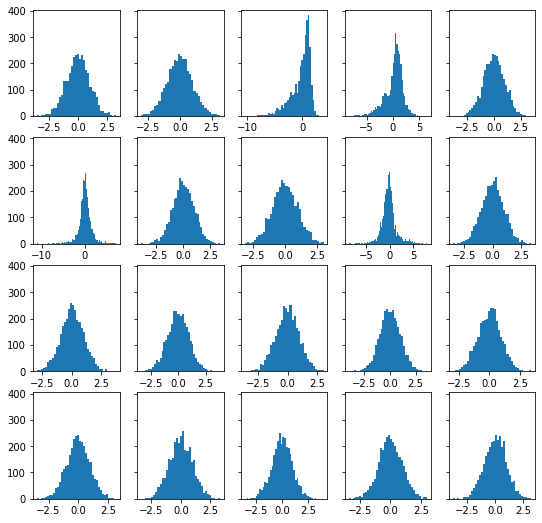

In [71]:
# Create two subplots and unpack the output array immediately
plt.rcParams["figure.figsize"] = (9, 9)

f, axs = plt.subplots(4, 5, sharey=True)
axs[0,0].hist(z_all[:,0].cpu().detach().numpy(), bins='auto')
axs[0,1].hist(z_all[:,1].cpu().detach().numpy(), bins='auto')
axs[0,2].hist(z_all[:,2].cpu().detach().numpy(), bins='auto')
axs[0,3].hist(z_all[:,3].cpu().detach().numpy(), bins='auto')
axs[0,4].hist(z_all[:,4].cpu().detach().numpy(), bins='auto')
axs[1,0].hist(z_all[:,5].cpu().detach().numpy(), bins='auto')
axs[1,1].hist(z_all[:,6].cpu().detach().numpy(), bins='auto')
axs[1,2].hist(z_all[:,7].cpu().detach().numpy(), bins='auto')
axs[1,3].hist(z_all[:,8].cpu().detach().numpy(), bins='auto')
axs[1,4].hist(z_all[:,9].cpu().detach().numpy(), bins='auto')
axs[2,0].hist(z_all[:,10].cpu().detach().numpy(), bins='auto')
axs[2,1].hist(z_all[:,11].cpu().detach().numpy(), bins='auto')
axs[2,2].hist(z_all[:,12].cpu().detach().numpy(), bins='auto')
axs[2,3].hist(z_all[:,13].cpu().detach().numpy(), bins='auto')
axs[2,4].hist(z_all[:,14].cpu().detach().numpy(), bins='auto')
axs[3,0].hist(z_all[:,15].cpu().detach().numpy(), bins='auto')
axs[3,1].hist(z_all[:,16].cpu().detach().numpy(), bins='auto')
axs[3,2].hist(z_all[:,17].cpu().detach().numpy(), bins='auto')
axs[3,3].hist(z_all[:,18].cpu().detach().numpy(), bins='auto')
axs[3,4].hist(z_all[:,19].cpu().detach().numpy(), bins='auto')





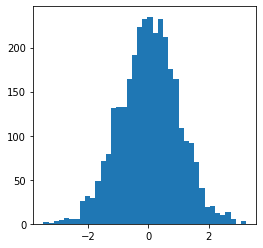

In [67]:

_ = plt.hist(z_all[:,0].cpu().detach().numpy(), bins='auto')  # arguments are passed to np.histogram
#>>> plt.title("Histogram with 'auto' bins")
#Text(0.5, 1.0, "Histogram with 'auto' bins")
plt.show()

In [384]:
bn_all_np = x_encoded.cpu().detach().numpy()
#bn_all_np = mu_all.cpu().detach().numpy()
#bn_all_np = z_all.cpu().detach().numpy()
bn_df = pd.DataFrame(bn_all_np)
bn_df.columns = ['bn'+str(i+1) for i in bn_df.columns]

In [385]:
bn_df.head()

,bn1,bn2,bn3,bn4,bn5,bn6,bn7,bn8,bn9,bn10,...,bn14,bn15,bn16,bn17,bn18,bn19,bn20,bn21,bn22,bn23
0,-0.070704,-0.008642,0.083836,0.026779,0.411511,-1.179554,-0.301631,0.893285,-0.378844,-0.328554,...,-0.183975,-0.307727,-0.650664,0.836242,0.731863,-2.260756,-0.983068,-0.036785,-0.124284,-0.029695
1,0.054682,0.014900,0.080491,0.083546,-0.063008,-1.067664,0.127872,1.355083,-0.325856,-0.620360,...,-0.278076,0.558437,-0.087373,3.175098,3.403774,-4.737239,-3.114881,-0.071295,-0.424502,-0.053626
2,0.010020,-0.109771,-0.038412,-0.112311,-0.493289,-0.039043,-0.378187,0.458341,-0.068049,3.090200,...,-0.100476,0.282012,0.263319,1.275925,0.524659,-2.196313,-2.543383,-0.110442,-2.749766,-0.172820
3,0.071727,0.081714,0.031931,0.027692,0.228794,-1.287911,-0.176476,1.165087,-0.317550,-0.904341,...,-0.058348,-0.317630,-0.807354,1.426266,1.031001,-2.633120,-1.223748,0.071198,0.279551,-0.054831
4,0.088664,-0.077402,0.064804,0.027378,0.441704,-1.727982,-0.055037,1.148711,-0.426117,-1.711105,...,-0.299767,0.099130,-0.754295,1.829323,2.016143,-3.189790,-1.307805,0.067207,1.068484,0.059219


In [386]:
cell_df = pd.DataFrame(bn_df.index,index=bn_df.index)
#tmp = pd.DataFrame(adata.X,index=adata.obs_names,columns=adata.var_names)
cell_df.head()

gene_df = pd.DataFrame(bn_df.columns,index=bn_df.columns)
#tmp = pd.DataFrame(adata.X,index=adata.obs_names,columns=adata.var_names)
gene_df.head()

adata_bn = sc.AnnData(bn_df.values, obs=cell_df, var=gene_df)

#sc.pp.pca(adata_t_tpm)

sc.pp.neighbors(adata_bn,n_neighbors=10)
#sc.pl.tsne(adata_fib_merge,color='louvain')

#sc.pl.tsne(adata_fib_merge,color='patient_id')

sc.tl.umap(adata_bn)

sc.tl.leiden(adata_bn,resolution=1)

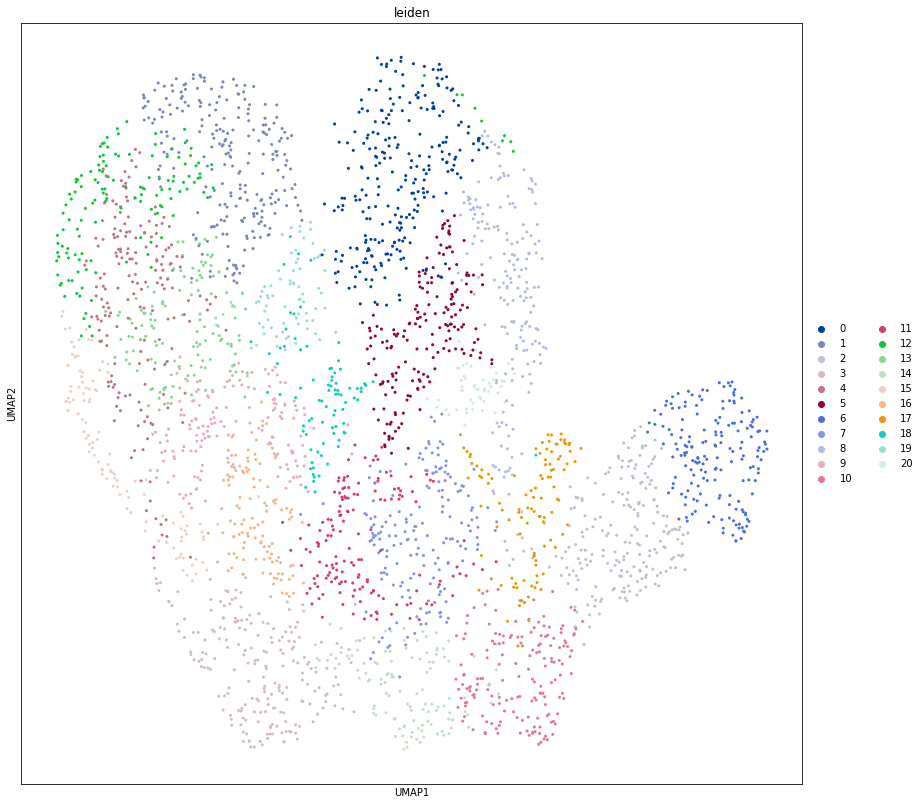

In [387]:
sc.pl.umap(adata_bn,color='leiden')

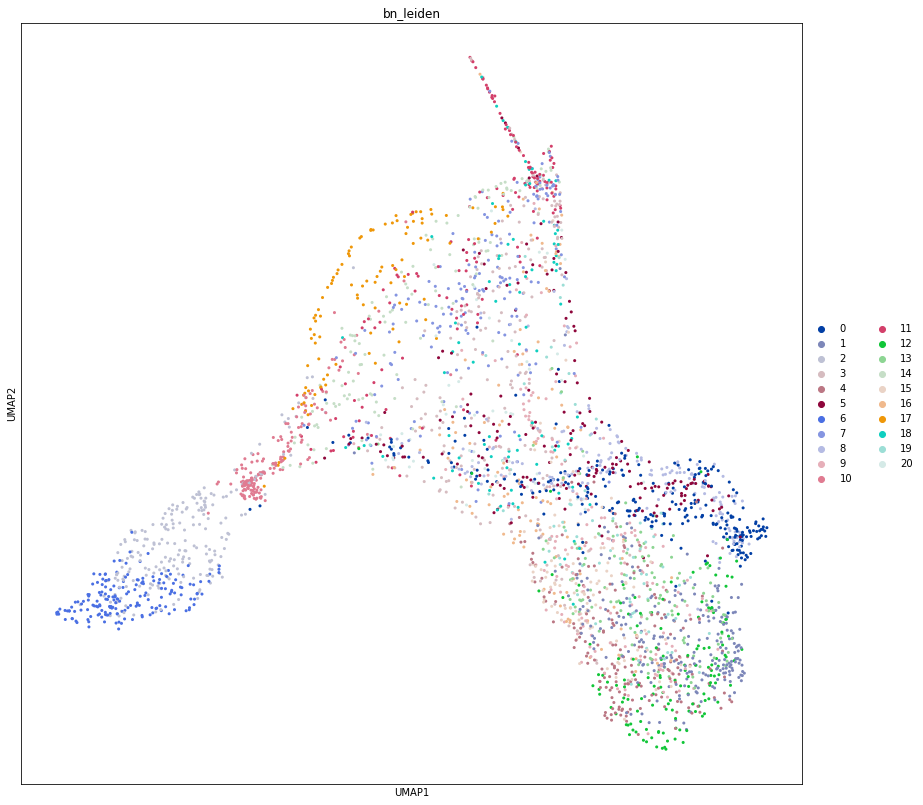

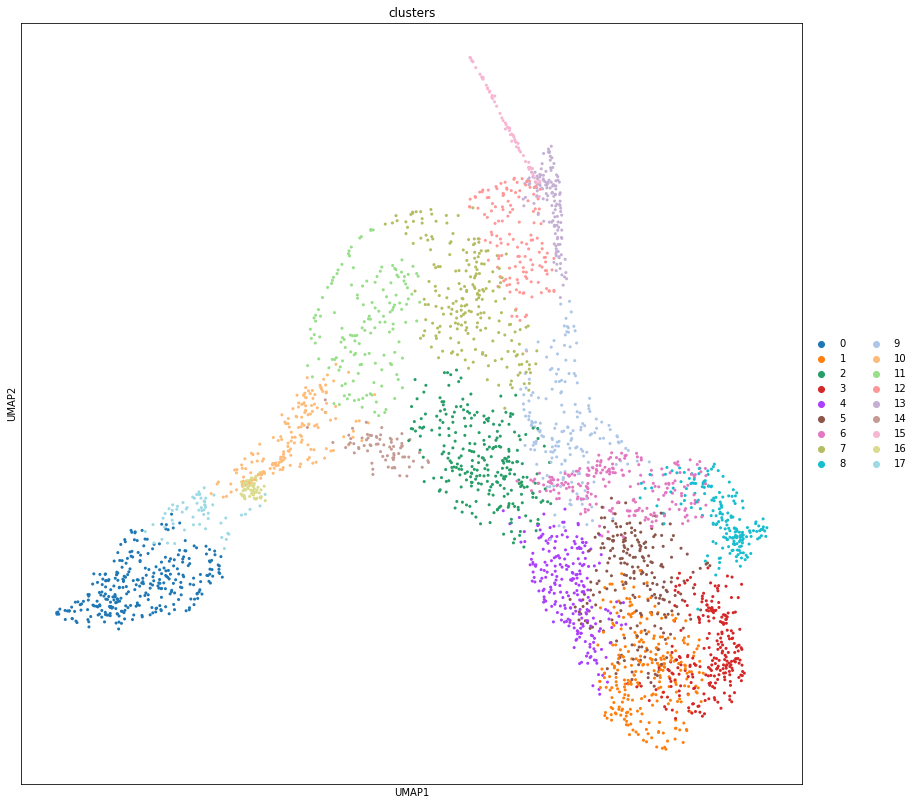

In [388]:
adA.obs['bn_leiden'] = adata_bn.obs.leiden.values

#clusters_colors = dict(
    #zip([str(i) for i in range(21)], adata.uns["clusters_colors"])
#)

sc.pl.umap(adA,color='bn_leiden')
sc.pl.umap(adA,color='clusters')

def csm(A,B):
    num=np.dot(A,B.T)
    p1=np.sqrt(np.sum(A**2,axis=1))[:,np.newaxis]
    p2=np.sqrt(np.sum(B**2,axis=1))[np.newaxis,:]
    return 1-num/(p1*p2)


def hinge_loss(yp, ya, margin=1):
    # yp is the bottleneck of a normal batch
    # ya is the bottleneck of pseduo spots
    # yp: [B, E] where B is batch size and E is bottleneck size
    # ya: [P, E] where E is number of pseudo spots
    #yp = yp.unsqueeze(dim=1) # B, 1, E
    #ya = ya.unsqueeze(dim=0) # 1, P, E
    dists = torch.tensor(csm(yp.detach().numpy(),ya.detach().numpy()))#1-np.dot(yp.detach().numpy(),ya.detach().numpy().T)/(np.linalg.norm(yp.detach().numpy())*np.linalg.norm(ya.detach().numpy()))#((yp-ya)**2).mean(dim=2) # B, P
    min_dists,_ = torch.topk(dists,k=2,dim=1,largest=False,sorted=True) #higher weights of loss on spots with only one cell type(purity score)
    # min_dists[:,0] is the shortest distances
    # min_dists[:,1] is the 2nd shortest distances
    loss = torch.maximum(min_dists[:,0] - min_dists[:,1], torch.tensor(-margin))#torch.maximum(min_dists[:,0] - min_dists[:,1], torch.tensor(-margin).cuda())
    return loss   

In [389]:
dt = tmp[tmp.columns.intersection(adA.var.loc[adA.var['highly_variable'] == True].index.values)]

bn_df.index = dt.index

for k in valid_cell_dic.keys():
    gs = valid_cell_dic[k]
    ttt = pd.concat([bn_df[bn_df.columns[bn_df.max(axis=0) > 0]], dt[dt.columns.intersection(gs)]], axis=1)
    
    tt = ttt.corr()
    
    for j in bn_df.columns.values[bn_df.max(axis=0) > 0]:
        data = np.array([tt[j].index,tt[j].tolist()])
        df = pd.DataFrame(data.T, columns = ['Name', 'cor_score']) 
        df.index = df['Name']
        df = df[~df.Name.str.contains("bn")]#df.drop(index=bn_df.columns.values[bn_df.max(axis=0) > 0].tolist())
        df_s = df.sort_values(by=['cor_score'], ascending=False)
        mask = df_s['cor_score']>0.5
        feas = df_s.loc[mask,'Name'].values
        print(k,j,feas)

cell_1 bn1 []
cell_1 bn2 []
cell_1 bn3 []
cell_1 bn4 []
cell_1 bn5 []
cell_1 bn6 ['CD74' 'HLA-A' 'APOE' 'TYROBP' 'IGKC' 'IGHG3']
cell_1 bn7 []
cell_1 bn8 ['CD24']
cell_1 bn9 []
cell_1 bn10 ['CD74' 'APOE' 'TYROBP' 'CTSB' 'HLA-A' 'CTSD' 'APOC1' 'FTL' 'COL1A1'
 'IGHG3' 'IGKC']
cell_1 bn11 []
cell_1 bn12 []
cell_1 bn13 ['COL1A1']
cell_1 bn14 []
cell_1 bn15 []
cell_1 bn16 ['COL1A1' 'CD74' 'HLA-A']
cell_1 bn17 ['CD24']
cell_1 bn18 []
cell_1 bn19 ['FTL' 'MMP9']
cell_1 bn20 []
cell_1 bn21 []
cell_1 bn22 []
cell_1 bn23 []
cell_3 bn1 []
cell_3 bn2 []
cell_3 bn3 []
cell_3 bn4 []
cell_3 bn5 []
cell_3 bn6 []
cell_3 bn7 []
cell_3 bn8 []
cell_3 bn9 []
cell_3 bn10 ['COL6A2' 'COL6A1' 'FBLN1']
cell_3 bn11 []
cell_3 bn12 []
cell_3 bn13 ['COL18A1' 'COL6A1' 'COL6A2']
cell_3 bn14 []
cell_3 bn15 []
cell_3 bn16 ['COL6A2' 'COL6A1']
cell_3 bn17 []
cell_3 bn18 []
cell_3 bn19 []
cell_3 bn20 []
cell_3 bn21 []
cell_3 bn22 []
cell_3 bn23 []
cell_4 bn1 []
cell_4 bn2 []
cell_4 bn3 []
cell_4 bn4 []
cell_4 bn5 []
cell_4

In [390]:
# mean cor matrix, dim: num_bn * num_ct
dt = tmp[tmp.columns.intersection(adA.var.loc[adA.var['highly_variable'] == True].index.values)]

bn_df.index = dt.index

# Declaring rows
N = len(bn_df.columns.values[bn_df.max(axis=0) > 0])#bn_df.shape[1]
  
# Declaring columns
M = len(valid_cell_dic)
  
# Using * operator twice to initialize matrix
cor_bn_ct = np.array([[0] * M] * N)
print(cor_bn_ct.shape)
#res[0,0]
cor_bn_ct_df = pd.DataFrame(cor_bn_ct, columns = valid_cell_dic.keys(), index = bn_df.columns.values[bn_df.max(axis=0) > 0])
cor_bn_ct_df.iloc[0,0]




(23, 23)


0

In [391]:
for k in valid_cell_dic.keys():
    gs = valid_cell_dic[k]
    ttt = pd.concat([bn_df[bn_df.columns[bn_df.max(axis=0) > 0]], dt[dt.columns.intersection(gs)].sum(axis=1)/dt.shape[0]], axis=1)
    
    tt = ttt.corr()
    
    for j in bn_df.columns.values[bn_df.max(axis=0) > 0]:
        data = np.array([tt[j].index,tt[j].tolist()])
        df = pd.DataFrame(data.T, columns = ['Name', 'cor_score']) 
        df.index = df['Name']
        #df = df[~df.Name.str.contains("bn")]#df.drop(index=bn_df.columns.values[bn_df.max(axis=0) > 0].tolist())
        #df_s = df.sort_values(by=['cor_score'], ascending=False)
        #mask = df_s['cor_score']>0.5
        #feas = df_s.loc[mask,'Name'].values
        cor_bn_ct_df.loc[j,k] = df['cor_score'][0]
        


In [392]:
cor_bn_ct_df.max()

cell_1                          0.794326
cell_3                          0.702680
cell_4                          0.704586
cell_6                          0.633272
cell_7                          0.706144
cell_8                          0.755845
cell_10                         0.654269
cell_11                         0.840432
cell_12                         0.636695
Th17                            0.428163
Treg                            0.640802
Th9                             0.608719
CD8 T cell \nactivation         0.689142
CD8+ deletional \ntolerance     0.348286
CD8+ TIL \ndysfunction          0.538446
Effector cell \ncytotoxicity    0.670798
bcell                           0.577542
Fibroblast                      0.737057
Monocyte                        0.623220
Macrophage                      0.719754
NK                              0.589222
BC                              0.227705
GNF2_MKI67                      0.389429
dtype: float64

In [393]:
cell_dic.keys()

dict_keys(['cell_1', 'cell_3', 'cell_4', 'cell_6', 'cell_7', 'cell_8', 'cell_10', 'cell_11', 'cell_12', 'Th17', 'Treg', 'Th9', 'CD8 T cell \nactivation', 'Exhaustion/Terminal \ndifferentiation', 'CD8+ deletional \ntolerance', 'CD8+ TIL \ndysfunction', 'Effector cell \ncytotoxicity', 'bcell', 'Fibroblast', 'Monocyte', 'Macrophage', 'NK', 'BC', 'GNF2_MKI67'])

In [394]:
x_sample_cell.cpu().detach().numpy()

array([[ 1.89330280e-01,  1.99106708e-03,  8.82917084e-05,
         1.71401165e-02,  8.84942561e-02,  2.73958668e-02,
        -2.40272842e-02,  1.48408785e-01, -1.45660583e-02,
        -3.28142568e-03,  5.17053232e-02,  1.32099405e-01,
         9.77980793e-02, -1.03926003e-01,  8.07553902e-03,
         2.35920683e-01, -3.63924503e-02, -4.24285531e-02,
         5.21637052e-02, -8.92490149e-04, -2.22284608e-02,
         2.31099129e-02,  1.18764304e-01],
       [-2.92033609e-02,  4.10626084e-02,  1.61385015e-02,
        -5.97268753e-02, -4.50064987e-02,  8.50300044e-02,
         2.06129700e-02, -1.59078352e-02,  3.16591561e-02,
        -2.26035863e-02, -6.55084196e-03,  4.57045138e-02,
        -2.99638510e-02,  3.64811346e-02,  1.60008930e-02,
         2.92842090e-03, -1.32317096e-02,  9.29036587e-02,
         5.62155694e-02,  3.44248861e-02,  3.88970487e-02,
        -3.43427062e-03, -2.82190908e-02],
       [-1.92953330e-02,  1.04538426e-02,  7.12792873e-02,
        -5.05130664e-02, -5.3

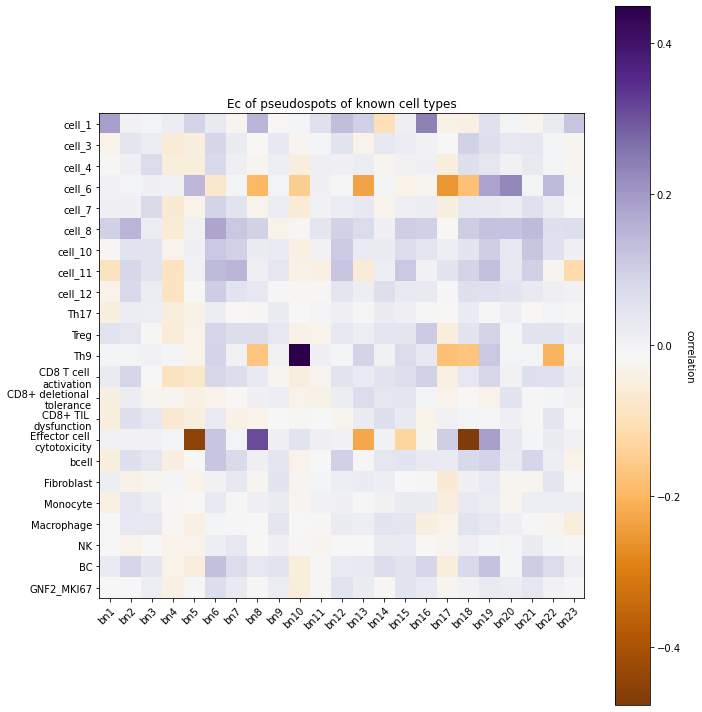

In [400]:

fig, ax = plt.subplots()

im = ax.imshow(x_sample_cell.cpu().detach().numpy(),
               cmap="PuOr")

cbar = ax.figure.colorbar(im, ax=ax)#, **cbar_kw
cbar.ax.set_ylabel('correlation', rotation=-90, va="bottom")
    
# We want to show all ticks...
ax.set_xticks(np.arange(len(cor_bn_ct_df.index)))
ax.set_yticks(np.arange(len(cor_bn_ct_df.columns)))
# ... and label them with the respective list entries
ax.set_xticklabels(cor_bn_ct_df.index)
ax.set_yticklabels(cor_bn_ct_df.columns)

# Rotate the tick labels and set their alignment.
plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
         rotation_mode="anchor")

# Loop over data dimensions and create text annotations.
#for i in range(len(cor_bn_ct_df.columns)):
#    for j in range(len(cor_bn_ct_df.index)):
#        text = ax.text(j, i, cor_bn_ct_df[i, j],
#                       ha="center", va="center", color="w")

plt.rcParams["figure.figsize"] = (9, 9)

ax.set_title("Ec of pseudospots of known cell types")
fig.tight_layout()
plt.show()

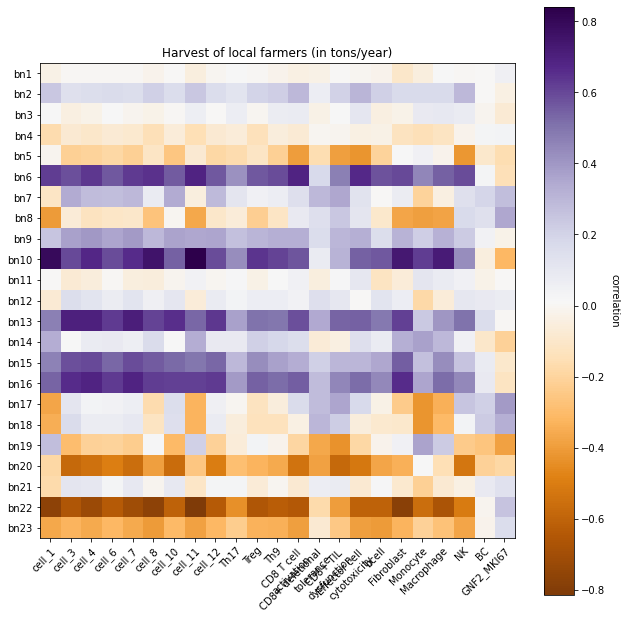

In [401]:
fig, ax = plt.subplots()

im = ax.imshow(cor_bn_ct_df,
               cmap="PuOr")

cbar = ax.figure.colorbar(im, ax=ax)#, **cbar_kw
cbar.ax.set_ylabel('correlation', rotation=-90, va="bottom")
    
# We want to show all ticks...
ax.set_xticks(np.arange(len(cor_bn_ct_df.columns)))
ax.set_yticks(np.arange(len(cor_bn_ct_df.index)))
# ... and label them with the respective list entries
ax.set_xticklabels(cor_bn_ct_df.columns)
ax.set_yticklabels(cor_bn_ct_df.index)

# Rotate the tick labels and set their alignment.
plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
         rotation_mode="anchor")

# Loop over data dimensions and create text annotations.
#for i in range(len(cor_bn_ct_df.columns)):
#    for j in range(len(cor_bn_ct_df.index)):
#        text = ax.text(j, i, cor_bn_ct_df[i, j],
#                       ha="center", va="center", color="w")

plt.rcParams["figure.figsize"] = (12, 12)

ax.set_title("Harvest of local farmers (in tons/year)")
fig.tight_layout()
plt.show()

Text(684.3749999999999, 0.5, '')

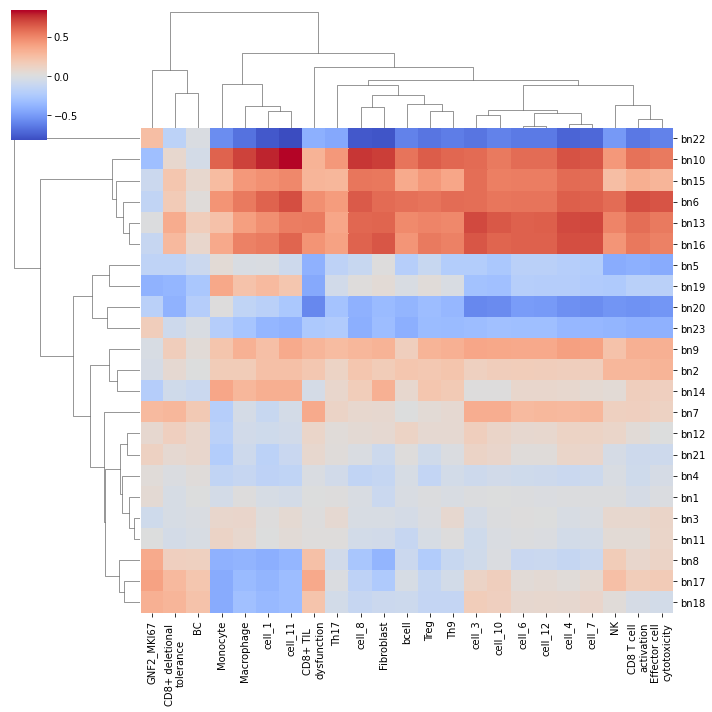

In [403]:
g=sns.clustermap(cor_bn_ct_df,cmap='coolwarm')
ax = g.ax_heatmap
ax.set_ylabel("")

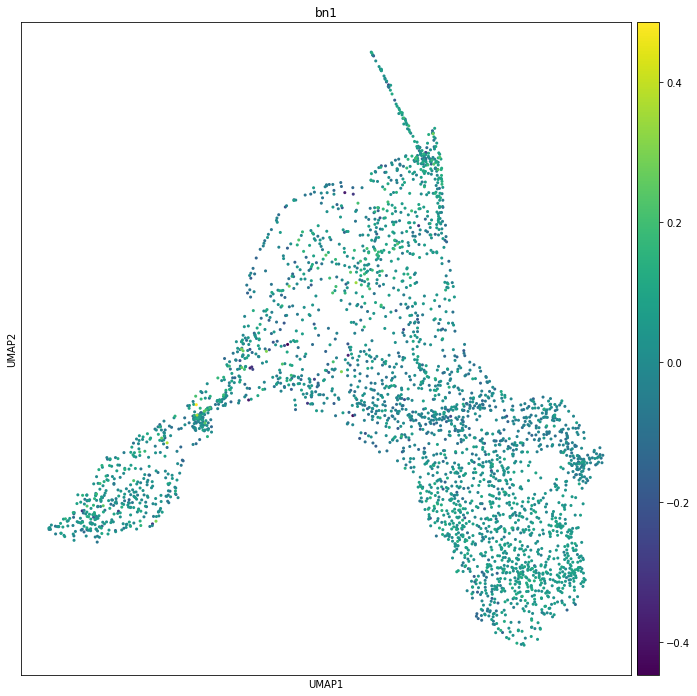

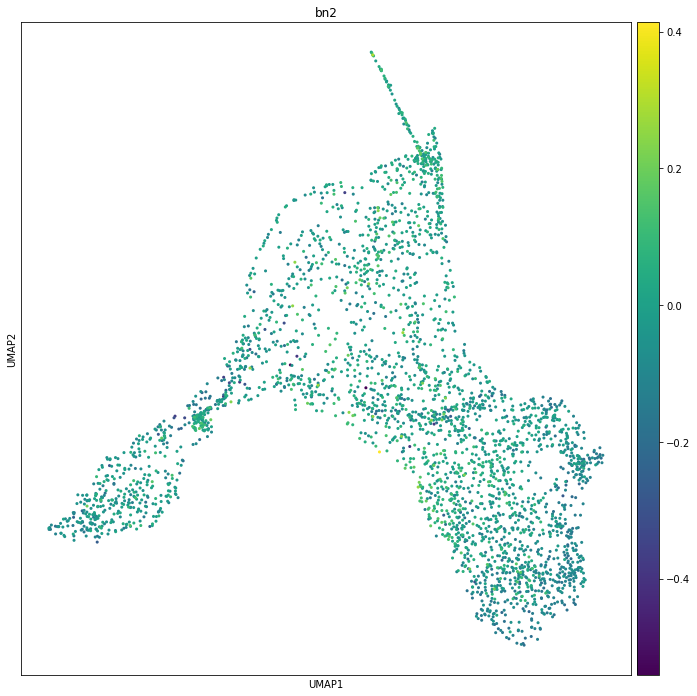

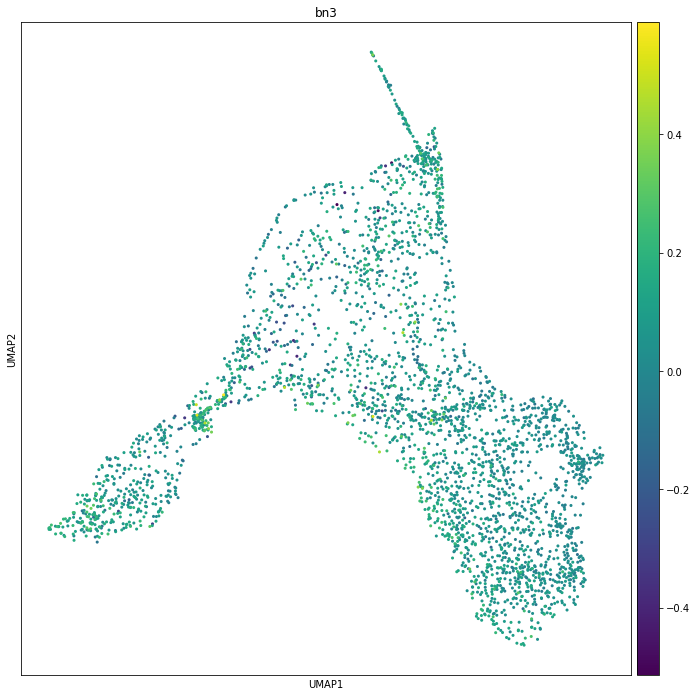

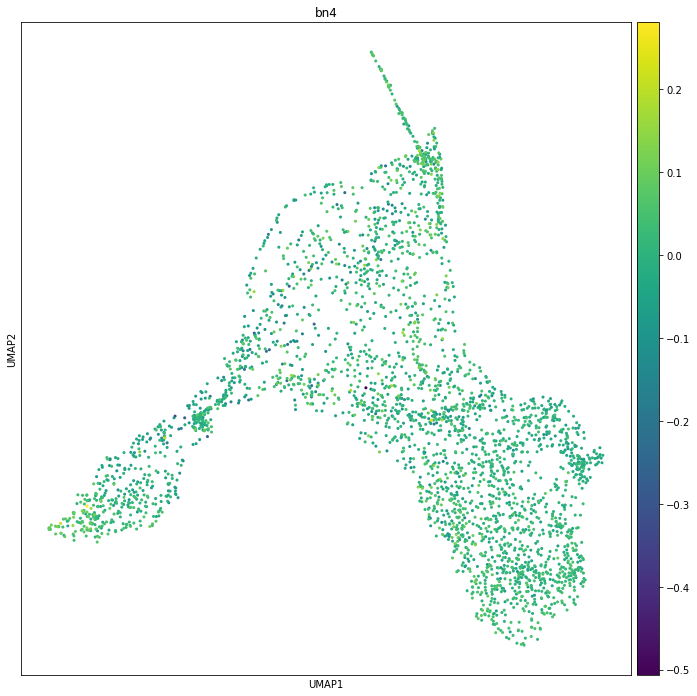

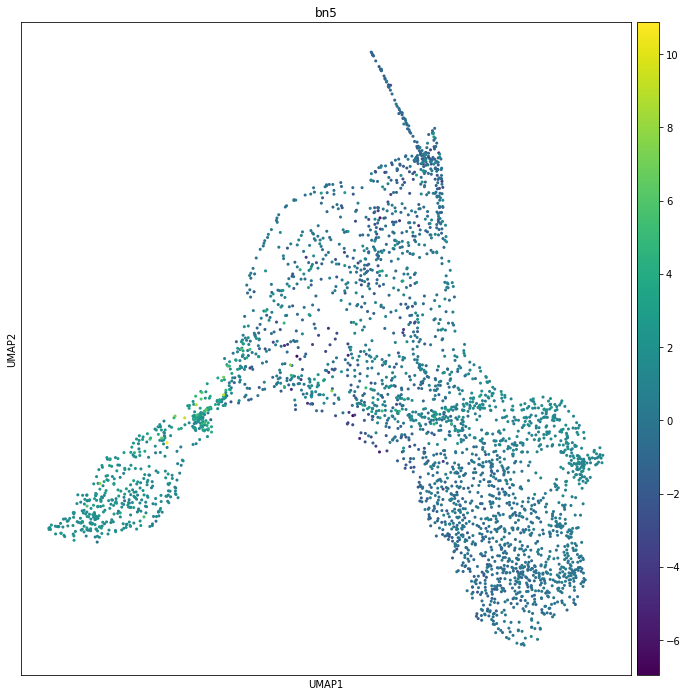

...

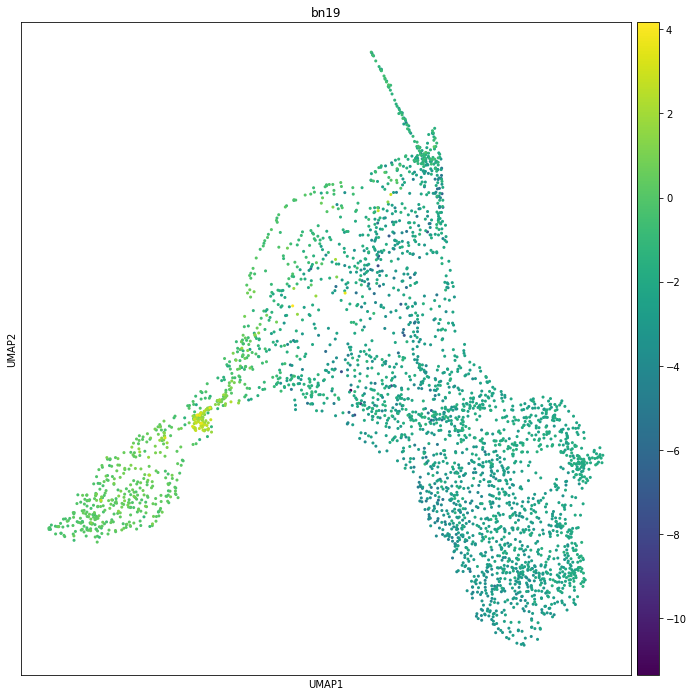

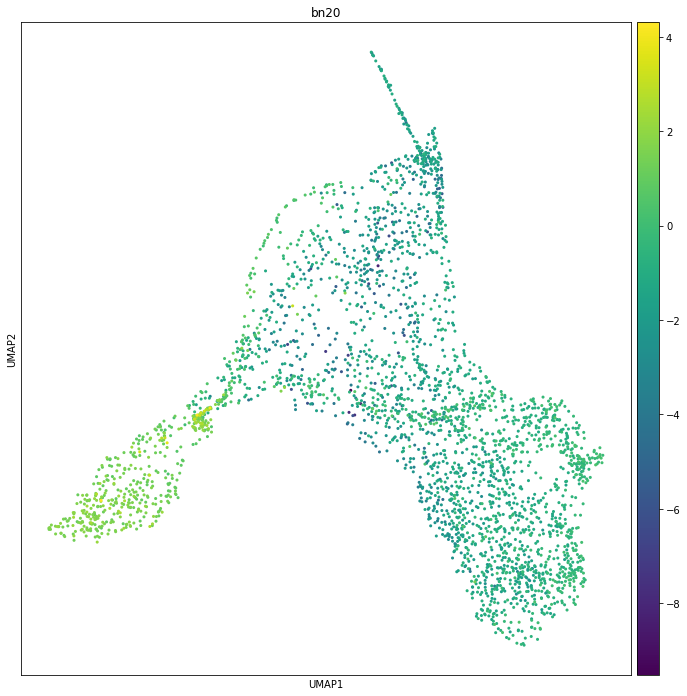

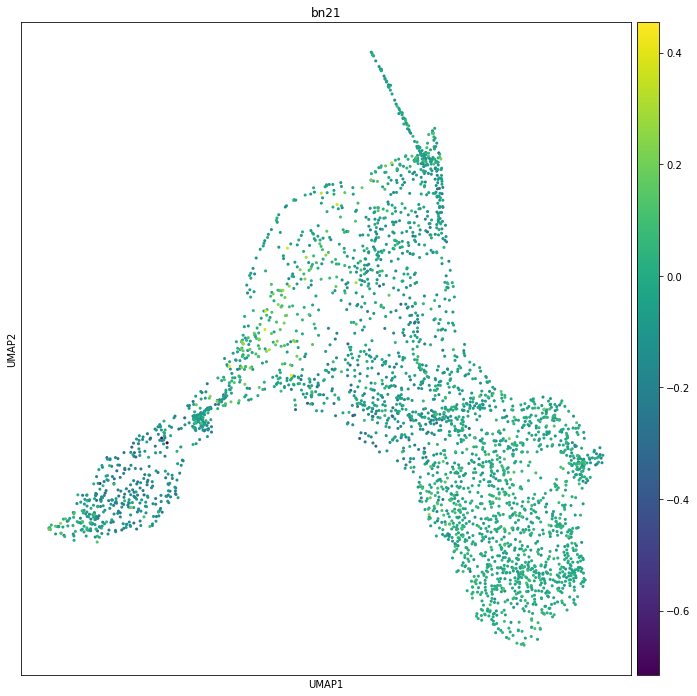

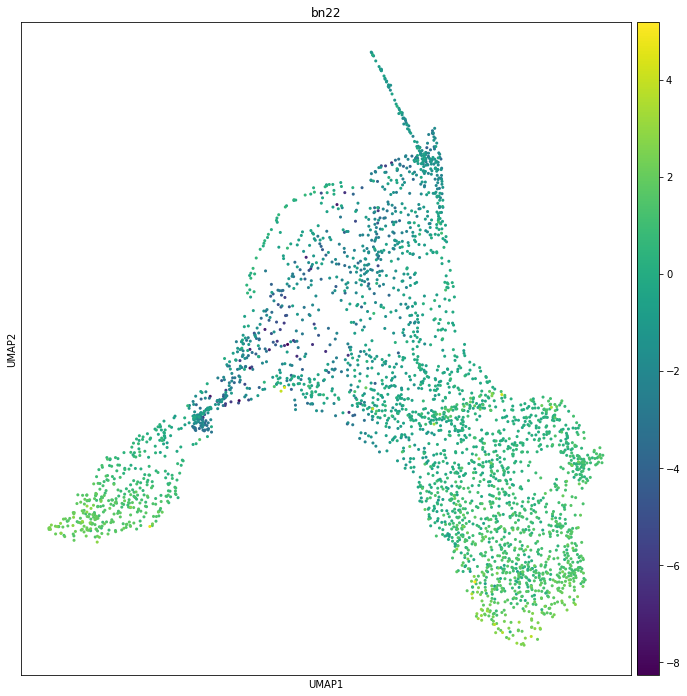

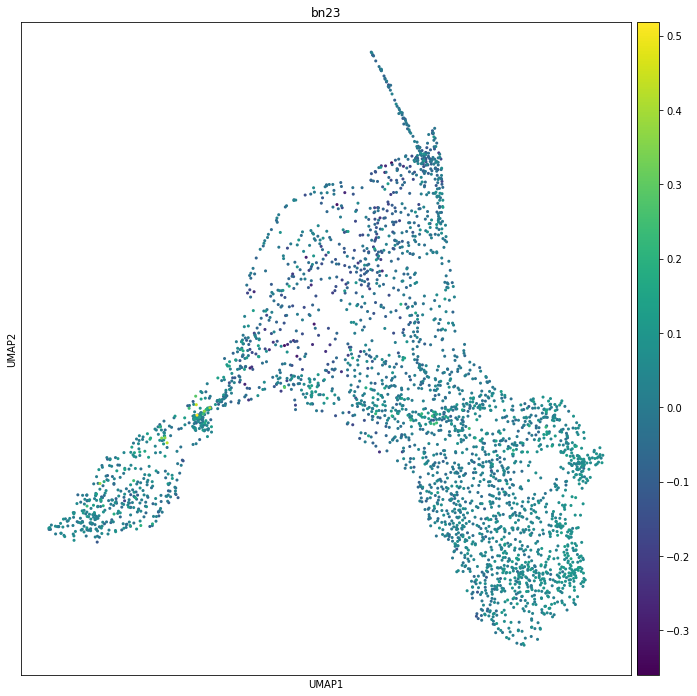

In [404]:
for i in bn_df.columns:
    adA.obs[i] = bn_df[i].values
    sc.pl.umap(adA, color=i)

Text(782.9999999999999, 0.5, '')

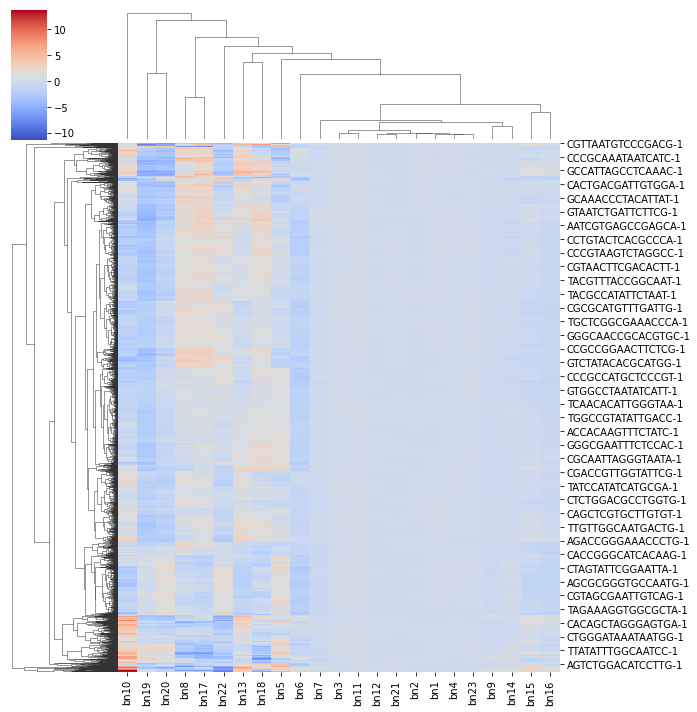

In [405]:
g=sns.clustermap(bn_df,cmap='coolwarm')
ax = g.ax_heatmap
ax.set_ylabel("")

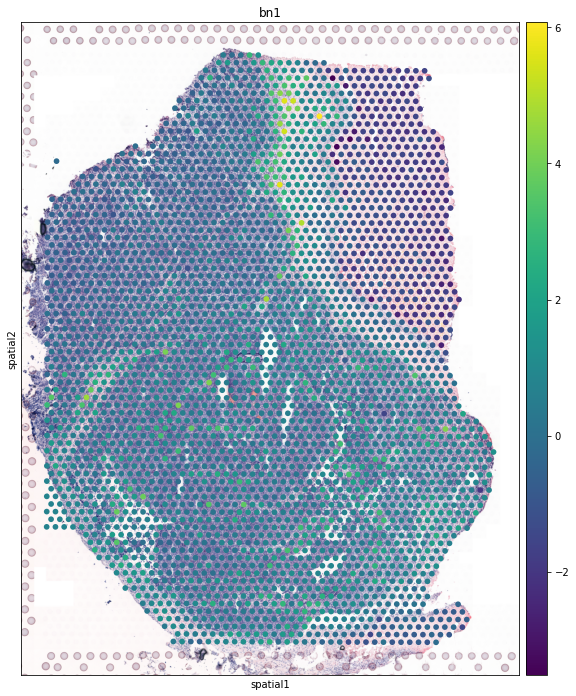

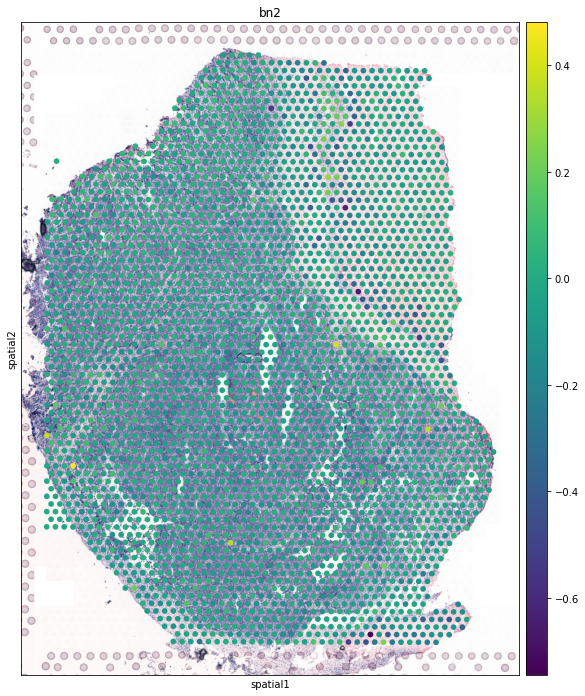

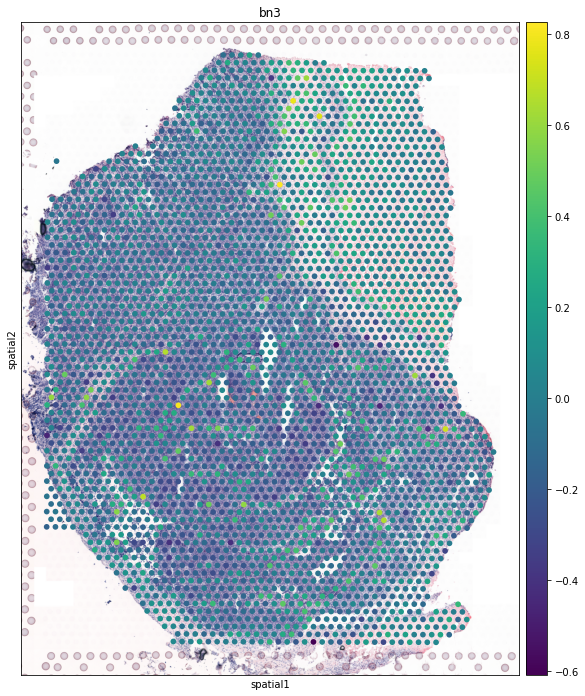

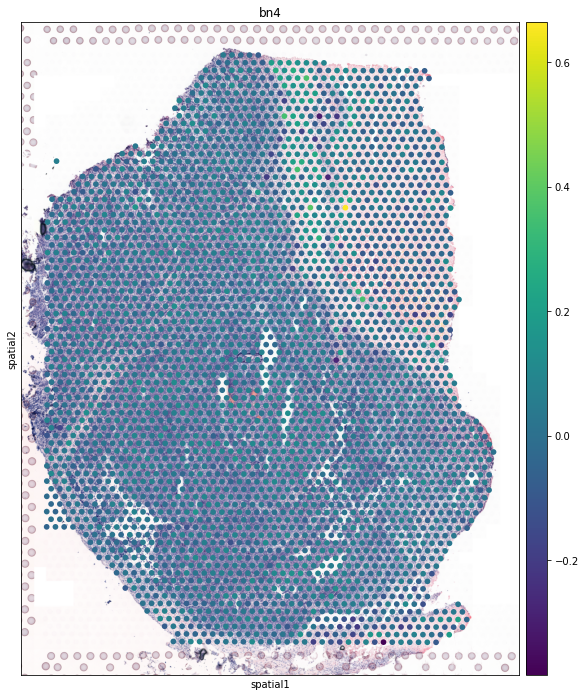

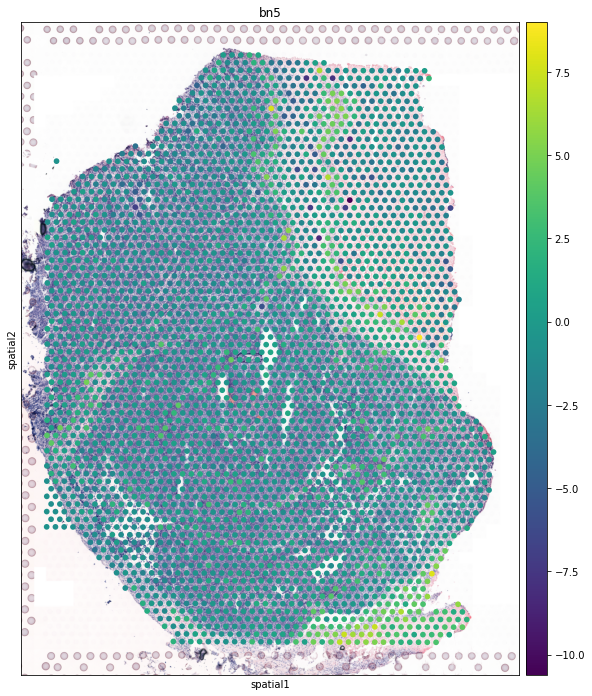

...

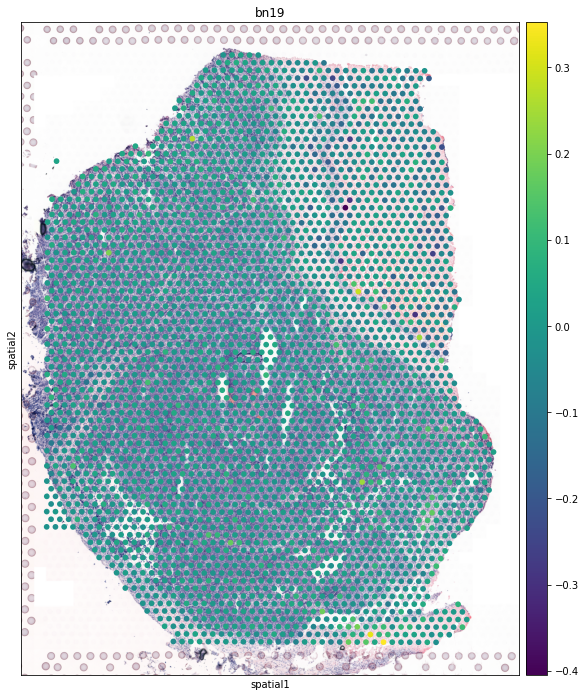

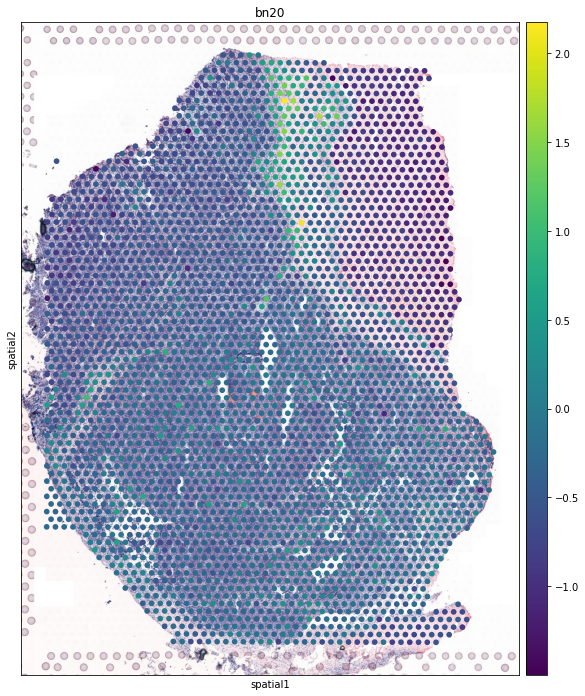

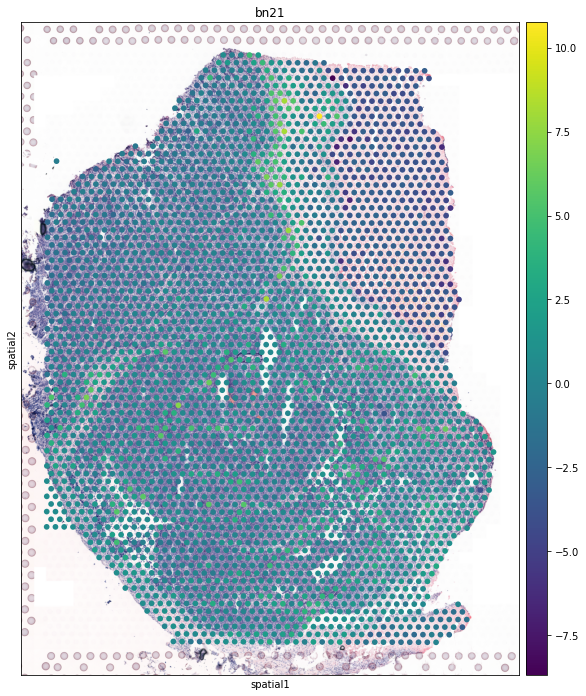

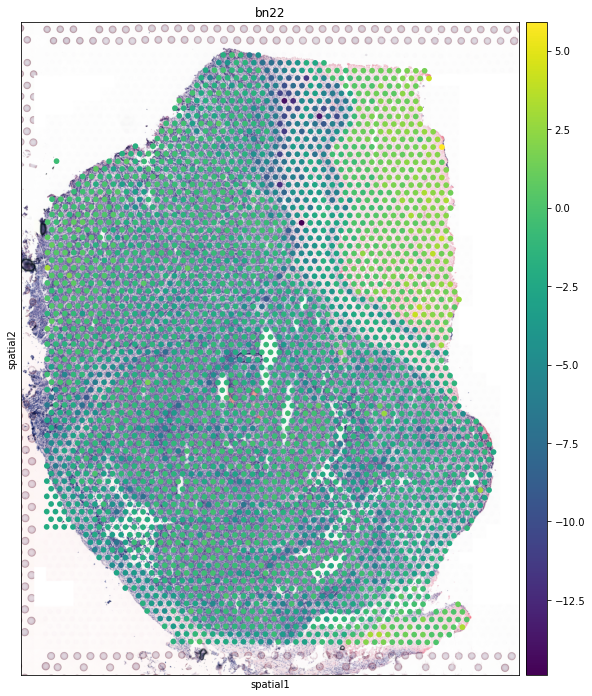

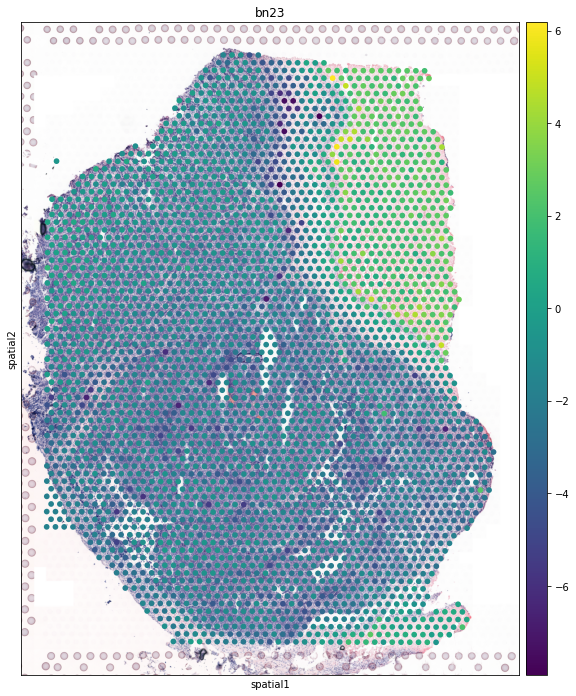

In [132]:
for ii in bn_df.columns:
    
        sc.pl.spatial(
        adA,
        img_key="hires",
        
        color=ii
        
    )

# adB

In [107]:
def correlation_coefficient(X,Y):
    # E((X-uX)(Y-uY))/std(X)/std(Y)
    # X,Y are 1-d pytorch tensors
    # X,Y mush have the same length
    assert X.shape[0] == Y.shape[0]
    n = X.shape[0]
    ux = X.mean()
    uy = Y.mean()
    sx = X.std() + 1e-7
    sy = Y.std() + 1e-7
    return ((X-ux)*(Y-uy)).mean()/sx/sy/(n-1)*n  




In [108]:
def one_bn_one_cell_correlation(bn_i, cell_j):
    # bn_i: the value of i_th bottleneck neuron
    # cell_j: the gene expresseions of j_th cell
    # bn_i shape: [B], where B is the batch size
    # cell_j shape: [B,G], where G is the number of genes of cell_j
    # return mean correlation coefficient of bn_i w.r.t cell_j's genes
    result = 0
    for k in range(cell_j.shape[1]):
        result += correlation_coefficient(bn_i, cell_j[:,k])
    return result/cell_j.shape[1]

In [109]:
def all_bn_all_cell_correlation(bn, cells):
    # bn: the value of bottleneck neurons
    # bn shape: [B,N], where B is the batch size, 
    #              N is the number of neurons in bottleneck layer
    # cells: a list of predefined M cells
    #      each element is the gene expression of that cell
    #      element shape: [B,G], where G is the number of genes of cell_j  
    # return shape [N,M] the correlation coefficient of each bottleneck 
    #        neuron w.r.t. gene expressions of each cell
    result = []
    for b in range(bn.shape[1]):
        tmp = []
        for cell in cells:
            tmp.append(one_bn_one_cell_correlation(bn[:,b],cell))
        tmp = torch.stack(tmp)
        result.append(tmp)
    result = torch.stack(result)
    return result

In [110]:
def hinge_loss_corr(corr, margin=2):
    # corr is a correlation coefficient matrix
    #      shape: [M,N]
    # where M is number of predefined cells
    #       N is number of bottleneck neurons
    
    
    min_dists,_ = torch.topk(corr,k=2,dim=1,sorted=True,largest=True) #higher weights of loss on spots with only one cell type(purity score)
    # min_dists[:,0] is the shortest distances
    # min_dists[:,1] is the 2nd shortest distances
    loss = torch.maximum(min_dists[:,1] - min_dists[:,0] + margin, torch.tensor(0))#torch.maximum(min_dists[:,0] - min_dists[:,1], torch.tensor(-margin).cuda())
    return loss.mean()

In [111]:
sampleB_path = "/home/jiwei/miao/bc_visium_mod/data/2B/"#'/home/jiwei/miao/bc_visium/MICHELLE_0212_AHJTWTDRXX__Project_10778__Sample_Patient2B_021120_IGO_10778_4/outs/' #path to directory with 'spatial' file
sampleB_count = 'filtered_feature_bc_matrix.h5'
adB = scanpy.read_visium(path=sampleB_path, count_file = sampleB_count, library_id='2B')
adB.var_names_make_unique()

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [112]:
sc.pp.normalize_total(adB, inplace=True)
sc.pp.log1p(adB)
sc.pp.highly_variable_genes(adB, flavor="seurat", n_top_genes=6000, inplace=True)

In [113]:
tmp = pd.DataFrame(adB.X.toarray(),index=adB.obs.index.values,columns=adB.var.index.values)
tmp.index.name = 'cell_id'
print(tmp.shape)

dt = tmp[tmp.columns.intersection(adB.var.loc[adB.var['highly_variable'] == True].index.values)]
vd = visiumDataset(exp_mat=dt)
dt.shape

(3202, 33538)


(3202, 6000)

In [114]:
batch_size = 128

train_loader = torch.utils.data.DataLoader(
                 dataset=vd,#dataset=train_set,
                 batch_size=batch_size,
                 shuffle=True,
                 num_workers=8,
                 #prefetch_factor=64,
)

x = next(iter(train_loader))
x.shape

x.min(), x.max(), x.mean()



genes = dt.columns.values#[i.lower() for i in dt.columns]

valid_cell_dic = {}
for c,m1 in cell_dic.items():
    m2 = [i for i in m1 if i in genes]
    #print(c,m2)
    if len(m2)>0:
        valid_cell_dic[c] = m2

In [115]:
cell_gene_ids = {}
gene2id = {i:c for c,i in enumerate(dt.columns.values.tolist())}
for k,v in valid_cell_dic.items():
    cell_gene_ids[k] = [gene2id[j] for j in v]

In [116]:
class AutoEncoder(nn.Module):
    def __init__(self):
        super(AutoEncoder,self).__init__()
        
        #encoder
        self.e1 = nn.Linear(6000,250)
        #self.e2 = nn.Linear(1000,500)
        #self.e2 = nn.Linear(500,250)
        #Latent View
        self.lv = nn.Linear(250,50)
        
        #Decoder
        self.d1 = nn.Linear(50,250)
        #self.d2 = nn.Linear(250,500)
        #self.d3 = nn.Linear(500,1000)
        
        self.output_layer = nn.Linear(250,6000)
        
    def forward(self,x,output_only=True):
        #x = x.view(-1,8440)
        input = x
        x = F.relu(self.e1(x))
        #x = F.relu(self.e2(x))
        #x = F.relu(self.e3(x))
        
        bottle_neck = F.relu(self.lv(x))
        x = F.relu(self.lv(x))#torch.sigmoid(self.lv(x))
        
        x = F.relu(self.d1(x))
        #x = F.relu(self.d2(x))
        #x = F.relu(self.d3(x))
        
        x = self.output_layer(x) # dim(x) = B, F
        x = (x - input).pow(2).mean(dim=1) # dim(x) = B
        if output_only:
            return x
        else:
            return x,bottle_neck
        

In [117]:
ae_gpu

AutoEncoder(
  (e1): Linear(in_features=6000, out_features=250, bias=True)
  (lv): Linear(in_features=250, out_features=50, bias=True)
  (d1): Linear(in_features=50, out_features=250, bias=True)
  (output_layer): Linear(in_features=250, out_features=6000, bias=True)
)

In [118]:
%%time

# move data to gpu
tmp = pd.DataFrame(adB.X.toarray(),index=adB.obs.index.values,columns=adB.var.index.values)
tmp.index.name = 'cell_id'


dt = tmp[tmp.columns.intersection(adB.var.loc[adB.var['highly_variable'] == True].index.values)]


ae_gpu = AutoEncoder()#.cuda()
#print(ae_gpu)
#p_spots = torch.from_numpy(p_spots_numpy).float()#.cuda()


loss_func = nn.MSELoss()
optimizer = torch.optim.Adam(ae_gpu.parameters(),lr=1e-3)

losses = []
EPOCHS = 100
for epoch in range(EPOCHS):
    for batch_idx,data in enumerate(train_loader):
        #data = torch.autograd.Variable(data)
        data = data#.cuda()
        optimizer.zero_grad()
        pred,bn = ae_gpu(data,False)
        
        prior_cells = []
        for k,v in cell_gene_ids.items():
            prior_cells.append(data[:,v])
            
        corr = all_bn_all_cell_correlation(bn, prior_cells)#all_bn_all_cell_correlation(bn[:,1:30], prior_cells)#all_bn_all_cell_correlation(bn, prior_cells)
        loss_corr = hinge_loss_corr(corr)
        #print(corr)
        #print(loss_corr)
        #bn_np = bn.detach().numpy()#bn_all.cpu().detach().numpy()

        #bn_df = pd.DataFrame(bn_np)#,index=spot_gene_exp.index)
        #bn_df.columns = ['bn'+str(i+1) for i in bn_df.columns]

        # Declaring rows
        #N = len(bn_df.columns.values[bn_df.max(axis=0) > 0])#bn_df.shape[1]
  

        #M = len(valid_cell_dic)
    
        #bn_ct_cor = cal_bn_ct_cor(N, M,valid_cell_dic,bn_df,dt)
        #loss_cor = hinge_loss_cor(bn_ct_cor, margin=100)
        #pred_p,bn_p = ae_gpu(p_spots,False)
        sparseloss = torch.mean(torch.abs(bn))
        #h_loss = hinge_loss(bn, bn_p)#hinge_loss(bn, bn_p, margin=100)#.detach().numpy()
        loss = 0.1*loss_corr +  pred.mean() + 0.001*sparseloss#data.view(-1,784) 
        #loss = loss_func(pred, data)+0.001*sparseloss#data.view(-1,784)
        # save to logs to draw learning curve
        losses.append(loss.item())#(loss.cpu().item())
        loss.backward()
        optimizer.step()
        
    print('\r Train Epoch: {}/{} [{}/{} ({:.0f}%)]\tLoss: {:.6f}\tcor_loss: {:.6f}\ts_loss: {:.6f}'.format(
        epoch+1,
        EPOCHS,
        batch_idx * len(data), 
        len(train_loader.dataset),
        100. * batch_idx / len(train_loader), 
        loss.detach().item(),
        loss_corr.detach().numpy(),#h_loss.mean().cpu().detach().item(),
        sparseloss.detach().item()#sparseloss.mean().cpu().detach().item()
    ))

 Train Epoch: 1/100 [50/3202 (96%)]	Loss: 0.243978	cor_loss: 1.852895	s_loss: 0.331870
 Train Epoch: 2/100 [50/3202 (96%)]	Loss: 0.235999	cor_loss: 1.850000	s_loss: 0.169235
 Train Epoch: 3/100 [50/3202 (96%)]	Loss: 0.202420	cor_loss: 1.728364	s_loss: 0.206120
 Train Epoch: 4/100 [50/3202 (96%)]	Loss: 0.216402	cor_loss: 1.908389	s_loss: 0.315097
 Train Epoch: 5/100 [50/3202 (96%)]	Loss: 0.224624	cor_loss: 1.930311	s_loss: 0.235421
 Train Epoch: 6/100 [50/3202 (96%)]	Loss: 0.230402	cor_loss: 2.000000	s_loss: 0.226077
 Train Epoch: 7/100 [50/3202 (96%)]	Loss: 0.225054	cor_loss: 1.960000	s_loss: 0.382659
 Train Epoch: 8/100 [50/3202 (96%)]	Loss: 0.222227	cor_loss: 1.885818	s_loss: 0.332889
 Train Epoch: 9/100 [50/3202 (96%)]	Loss: 0.223448	cor_loss: 1.869169	s_loss: 0.380026
 Train Epoch: 10/100 [50/3202 (96%)]	Loss: 0.241748	cor_loss: 1.897345	s_loss: 0.317818
 Train Epoch: 11/100 [50/3202 (96%)]	Loss: 0.239733	cor_loss: 1.969524	s_loss: 0.358638
 Train Epoch: 12/100 [50/3202 (96%)]	Loss

In [119]:
alldata_loader = torch.utils.data.DataLoader(
                 dataset=vd,#dataset=train_set,
                 batch_size=len(vd),
                 #shuffle=True,
                 num_workers=8,
                 prefetch_factor=64,
)

In [120]:
for batch_idx,alldata in enumerate(alldata_loader):
    print(batch_idx,alldata.size()) 
    pred_all,bn_all = ae_gpu(alldata,output_only=False) 

bn_all_np = bn_all.detach().numpy()

bn_df = pd.DataFrame(bn_all_np)#,index=spot_gene_exp.index)
bn_df.columns = ['bn'+str(i+1) for i in bn_df.columns]
tmp = pd.DataFrame(adB.X.toarray(),index=adB.obs.index.values,columns=adB.var.index.values)
tmp.index.name = 'cell_id'
print(tmp.shape)

dt = tmp[tmp.columns.intersection(adB.var.loc[adB.var['highly_variable'] == True].index.values)]

bn_df.index = dt.index

0 torch.Size([3202, 6000])
(3202, 33538)


for batch_idx,alldata in enumerate(alldata_loader):
    print(batch_idx,alldata.size()) 
    pred_all,bn_all = ae_gpu(alldata.cuda(),output_only=False) 

bn_all_np = bn_all.cpu().detach().numpy()

bn_df = pd.DataFrame(bn_all_np)#,index=spot_gene_exp.index)
bn_df.columns = ['bn'+str(i+1) for i in bn_df.columns]
tmp = pd.DataFrame(adB.X.toarray(),index=adB.obs.index.values,columns=adB.var.index.values)
tmp.index.name = 'cell_id'
print(tmp.shape)

dt = tmp[tmp.columns.intersection(adB.var.loc[adB.var['highly_variable'] == True].index.values)]

bn_df.index = dt.index

Text(783.6249999999999, 0.5, '')

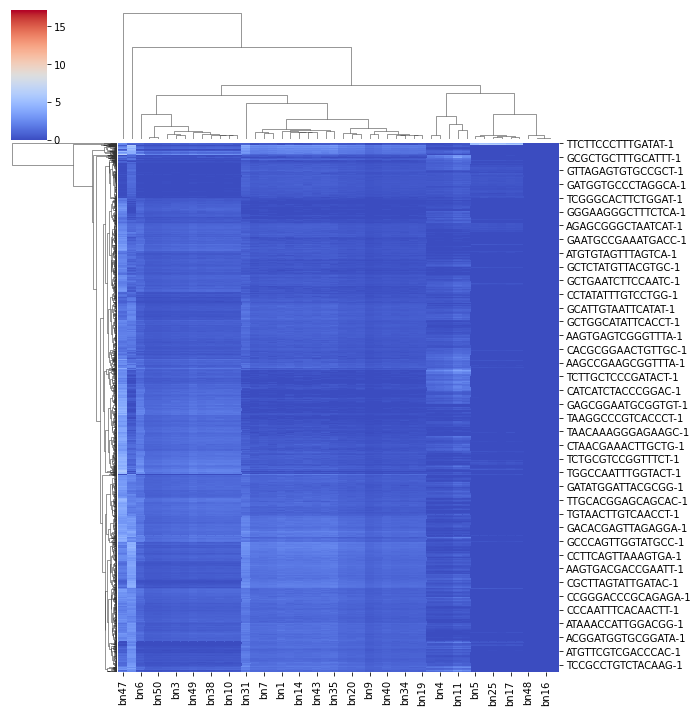

In [121]:
g=sns.clustermap(bn_df,cmap='coolwarm')
ax = g.ax_heatmap
ax.set_ylabel("")

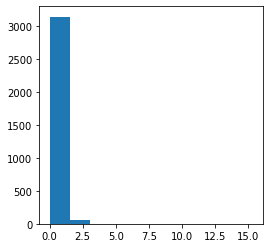

In [122]:
plt.hist(bn_df.bn2)
plt.show()

Text(684.3749999999999, 0.5, '')

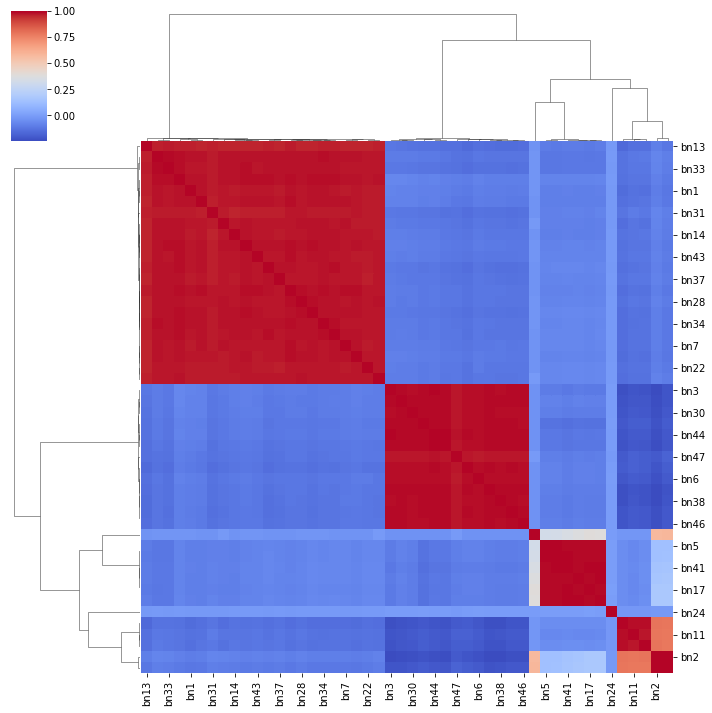

In [123]:
bn_cor = bn_df[bn_df.columns[bn_df.max(axis=0) > 0]].corr()
g=sns.clustermap(bn_cor,cmap='coolwarm')
ax = g.ax_heatmap
ax.set_ylabel("")

In [124]:
for k in valid_cell_dic.keys():
    gs = valid_cell_dic[k]
    tmp = pd.concat([bn_df[bn_df.columns[bn_df.max(axis=0) > 0]], dt[dt.columns.intersection(gs)]], axis=1)
    
    tt = tmp.corr()
    
    for j in bn_df.columns.values[bn_df.max(axis=0) > 0]:
        data = np.array([tt[j].index,tt[j].tolist()])
        df = pd.DataFrame(data.T, columns = ['Name', 'cor_score']) 
        df.index = df['Name']
        df = df[~df.Name.str.contains("bn")]#df.drop(index=bn_df.columns.values[bn_df.max(axis=0) > 0].tolist())
        df_s = df.sort_values(by=['cor_score'], ascending=False)
        mask = df_s['cor_score']>0.5
        feas = df_s.loc[mask,'Name'].values
        print(k,j,feas)

Th17 bn1 []
Th17 bn2 []
Th17 bn3 []
Th17 bn4 []
Th17 bn5 []
Th17 bn6 []
Th17 bn7 []
Th17 bn8 []
Th17 bn9 []
Th17 bn10 []
Th17 bn11 []
Th17 bn12 []
Th17 bn13 []
Th17 bn14 []
Th17 bn15 []
Th17 bn17 []
Th17 bn18 []
Th17 bn19 []
Th17 bn20 []
Th17 bn21 []
Th17 bn22 []
Th17 bn23 []
Th17 bn24 []
Th17 bn25 []
Th17 bn26 []
Th17 bn28 []
Th17 bn29 []
Th17 bn30 []
Th17 bn31 []
Th17 bn32 []
Th17 bn33 []
Th17 bn34 []
Th17 bn35 []
Th17 bn36 []
Th17 bn37 []
Th17 bn38 []
Th17 bn39 []
Th17 bn40 []
Th17 bn41 []
Th17 bn42 []
Th17 bn43 []
Th17 bn44 []
Th17 bn45 []
Th17 bn46 []
Th17 bn47 []
Th17 bn48 []
Th17 bn49 []
Th17 bn50 []
Treg bn1 []
Treg bn2 []
Treg bn3 []
Treg bn4 []
Treg bn5 []
Treg bn6 []
Treg bn7 []
Treg bn8 []
Treg bn9 []
Treg bn10 []
Treg bn11 []
Treg bn12 []
Treg bn13 []
Treg bn14 []
Treg bn15 []
Treg bn17 []
Treg bn18 []
Treg bn19 []
Treg bn20 []
Treg bn21 []
Treg bn22 []
Treg bn23 []
Treg bn24 []
Treg bn25 []
Treg bn26 []
Treg bn28 []
Treg bn29 []
Treg bn30 []
Treg bn31 []
Treg bn32 []
Treg

In [125]:
tmp = pd.DataFrame(adB.X.toarray(),index=adB.obs.index.values,columns=adB.var.index.values)
tmp.index.name = 'cell_id'
print(tmp.shape)

(3202, 33538)


In [126]:
# mean cor matrix, dim: num_bn * num_ct
dt = tmp[tmp.columns.intersection(adB.var.loc[adB.var['highly_variable'] == True].index.values)]

bn_df.index = dt.index

# Declaring rows
N = len(bn_df.columns.values[bn_df.max(axis=0) > 0])#bn_df.shape[1]
  
# Declaring columns
M = len(valid_cell_dic)
  
# Using * operator twice to initialize matrix
cor_bn_ct = np.array([[0] * M] * N)
print(cor_bn_ct.shape)
#res[0,0]
cor_bn_ct_df = pd.DataFrame(cor_bn_ct, columns = valid_cell_dic.keys(), index = bn_df.columns.values[bn_df.max(axis=0) > 0])
cor_bn_ct_df.iloc[0,0]

(48, 14)


0

In [127]:
for k in valid_cell_dic.keys():
    gs = valid_cell_dic[k]
    ttt = pd.concat([bn_df[bn_df.columns[bn_df.max(axis=0) > 0]], dt[dt.columns.intersection(gs)].sum(axis=1)/dt.shape[0]], axis=1)
    
    tt = ttt.corr()
    
    for j in bn_df.columns.values[bn_df.max(axis=0) > 0]:
        data = np.array([tt[j].index,tt[j].tolist()])
        df = pd.DataFrame(data.T, columns = ['Name', 'cor_score']) 
        df.index = df['Name']
        #df = df[~df.Name.str.contains("bn")]#df.drop(index=bn_df.columns.values[bn_df.max(axis=0) > 0].tolist())
        #df_s = df.sort_values(by=['cor_score'], ascending=False)
        #mask = df_s['cor_score']>0.5
        #feas = df_s.loc[mask,'Name'].values
        cor_bn_ct_df.loc[j,k] = df['cor_score'][0]
        
cor_bn_ct_df.max()

Th17                                     0.251419
Treg                                     0.348749
Th9                                      0.283020
CD8 T cell \nactivation                  0.353158
Exhaustion/Terminal \ndifferentiation    0.831112
CD8+ deletional \ntolerance              0.182109
CD8+ TIL \ndysfunction                   0.263318
Effector cell \ncytotoxicity             0.187583
bcell                                    0.403252
Fibroblast                               0.864761
Monocyte                                 0.297724
Macrophage                               0.710895
BC                                       0.140865
GNF2_MKI67                               0.881791
dtype: float64

Text(684.3749999999999, 0.5, '')

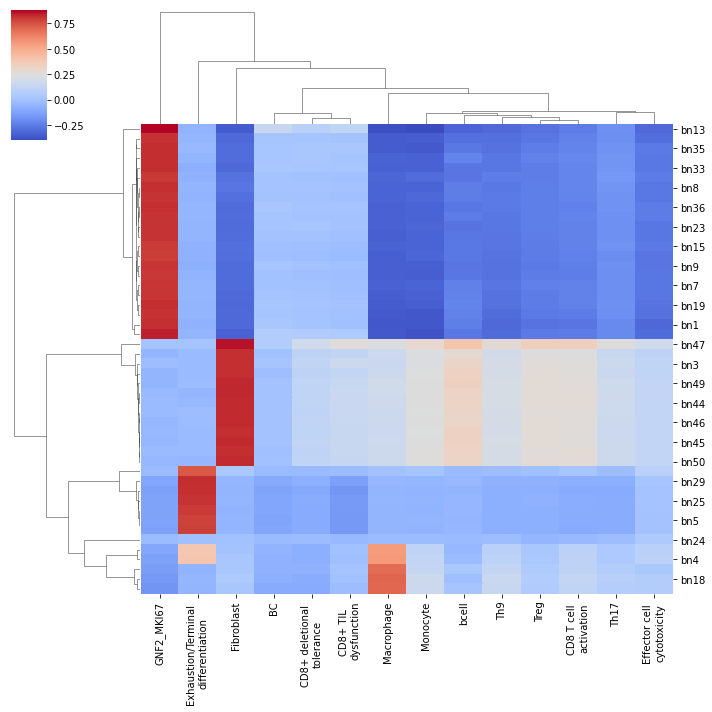

In [128]:
g=sns.clustermap(cor_bn_ct_df,cmap='coolwarm')
ax = g.ax_heatmap
ax.set_ylabel("")

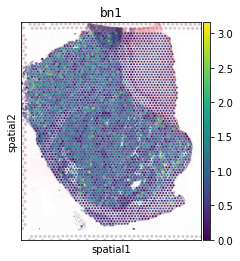

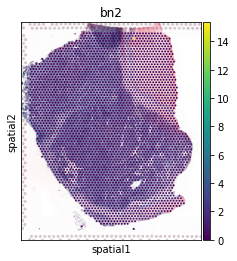

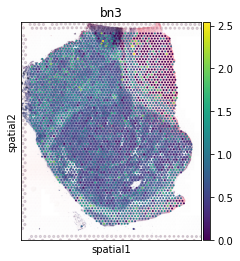

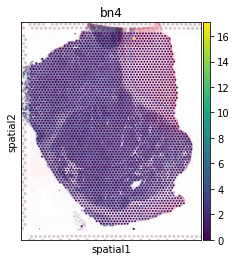

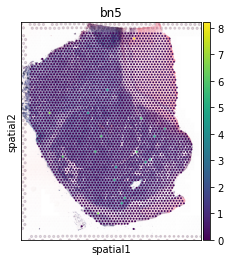

...

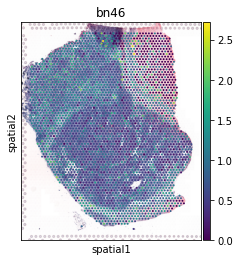

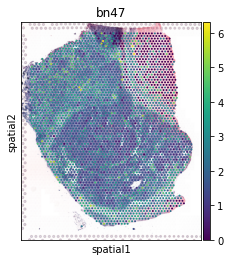

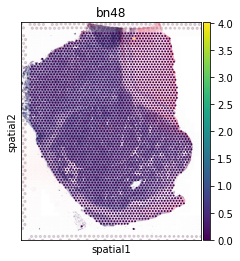

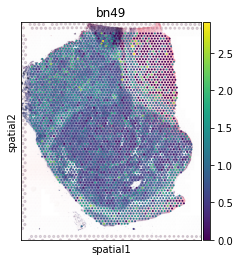

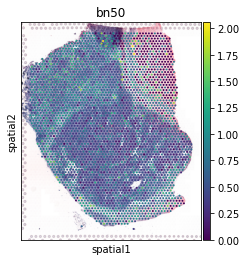

In [131]:
for ii in bn_df.columns:
        adB.obs[ii] = bn_df[ii].values
        sc.pl.spatial(
        adB,
        img_key="hires",
        
        color=ii
        
    )